# Analysis of original scRNA-seq data for Wen, Chandrasekaran et al. 2025 paper on  Wnt2 CPPs

### Import libraries

In [1]:
# core libraries
import scanpy as sc
import anndata as ad
import pandas as pd
import numpy as np

# sparse matrix support and statistics
import scipy
from scipy import stats

# plotting
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import rcParams

# don't print extraneous warnings
import warnings
warnings.filterwarnings("ignore")

# for pseudotime trajectory inference
from pygam import LinearGAM, PoissonGAM
import palantir

# batch correction (harmony-pytorch)
from harmony import harmonize

# doublet detection
import scvi
scvi.settings.verbosity = "WARNING"
scvi.settings.num_threads = 6

# helpers
from natsort import natsorted
import time
import itertools
from itertools import combinations
import os
import re
from path import Path
import glob
import subprocess
from joblib import Parallel, delayed
from tqdm import tqdm
tqdm.pandas()

# plotting preferences
sc.set_figure_params(dpi=96, dpi_save=400, color_map="viridis")
rcParams["image.aspect"]     = "equal"
rcParams['patch.edgecolor']  = "black"
rcParams['font.family']      = "Arial"
rcParams['figure.facecolor'] = "white"
rcParams['svg.fonttype']     = "none"

# local directories to save outputs
#os.mkdir("figures")
#os.mkdir("tables")

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


### Import the data

In [2]:
organism = "mmusculus"    #used for gene info lookup

identify_doublets = True  # run the SOLO doublet detection model
filter_doublets   = True  # actually remove predicted doublets

mixed_sex_samples = False # True if batches contain more than 1 sex in a batch

samples = [
    "1301032979_E10_5_WNT2_EYFP_S4",
    "WNT2_1183021942_S1",
    "6611852666_WNT2_E12-5_S1",
    "5546036195_wnt2_E17_5_heart_S5",
    "6225574879_wnt2_E17_5_lung_S6",
    "4966591972_WNT2KOE17_S3",
    "4128531267_WNT2HetE17_S4"
]

ages = [
    "E10.5",
    "E10.5",
    "E12.5",
    "E17.5",
    "E17.5",              
    "E17", 
    "E17"
]

disease = [
    "normal",
    "normal",
    "normal",
    "normal",
    "normal",
    "Wnt2 KO",
    "normal"
]

organ = [
    "heart,lung",
    "heart,lung",
    "heart,lung",
    "heart",
    "lung",
    "heart,lung",
    "heart,lung"
]

condition  = ["normal" if (x=="normal") else "KO" for x in disease] 

species    = [organism for d in ages] 

base_dir = "../data/"
solo_dir = "Solo.out/Velocyto/filtered/"
sub_dir  = "STARsolo/"

In [3]:
full_paths = [os.path.join(base_dir, sub_dir, samples[i], solo_dir) for i in range(0, len(samples))]

data = []

for d in full_paths:
    for f in [
        "barcodes.tsv.gz",
        "features.tsv.gz", 
        "unspliced.mtx.gz",
        "spliced.mtx.gz",
        "ambiguous.mtx.gz",
        "scAR_counts.mtx.gz"
    ]:
        if not(os.path.exists(d + f)):
            print("file not found: " + str(d+f))
            raise Exception

def read_data(i,d):
    obs = pd.read_csv(os.path.join(d,"barcodes.tsv.gz"), sep="\t", header=None, names=["CellID"], index_col=0)
    obs["batch"]     = samples[i]
    obs["age"]       = ages[i]
    obs["species"]   = species[i]
    obs["organ"]     = organ[i]
    obs["condition"] = condition[i]
    obs["disease"]   = disease[i]
    
    var = pd.read_csv(os.path.join(d, "features.tsv.gz"), sep="\t", header=None, names=["Gene", "Symbol", "Assay Type"], index_col=1)
    
    X_u    = scipy.io.mmread(os.path.join(d,"unspliced.mtx.gz")).tocsr().T
    X_s    = scipy.io.mmread(os.path.join(d,"spliced.mtx.gz")).tocsr().T
    X_a    = scipy.io.mmread(os.path.join(d,"ambiguous.mtx.gz")).tocsr().T
    X_scAR = scipy.io.mmread(os.path.join(d,"scAR_counts.mtx.gz")).tocsr().T # ambient RNA corrected counts
    X_u.eliminate_zeros()
    X_s.eliminate_zeros()
    X_a.eliminate_zeros()
    X_scAR.eliminate_zeros()
    X   = X_u + X_s + X_a
    
    a = ad.AnnData(
        obs=obs,
        var=var,
        X=X,
        layers={
            "counts_raw":  X,
            "counts_scAR": X_scAR,
            "unspliced":   X_u,
            "spliced" :    X_s
        }
    )
    
    a.var_names_make_unique()
    a.obs_names_make_unique()
    
    return a

n_jobs = np.min([8, len(samples)])

data = Parallel(n_jobs=n_jobs, verbose=10)(delayed(read_data)(i,d) for i,d in enumerate(full_paths))

for a in data:
    print(a)

[Parallel(n_jobs=7)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done   1 tasks      | elapsed:  2.8min
[Parallel(n_jobs=7)]: Done   2 out of   7 | elapsed:  7.9min remaining: 19.8min
[Parallel(n_jobs=7)]: Done   3 out of   7 | elapsed:  9.1min remaining: 12.2min
[Parallel(n_jobs=7)]: Done   4 out of   7 | elapsed: 10.4min remaining:  7.8min
[Parallel(n_jobs=7)]: Done   5 out of   7 | elapsed: 10.4min remaining:  4.2min


AnnData object with n_obs × n_vars = 5434 × 40176
    obs: 'batch', 'age', 'species', 'organ', 'condition', 'disease'
    var: 'Gene', 'Assay Type'
    layers: 'counts_raw', 'counts_scAR', 'unspliced', 'spliced'
AnnData object with n_obs × n_vars = 1458 × 40175
    obs: 'batch', 'age', 'species', 'organ', 'condition', 'disease'
    var: 'Gene', 'Assay Type'
    layers: 'counts_raw', 'counts_scAR', 'unspliced', 'spliced'
AnnData object with n_obs × n_vars = 6212 × 40176
    obs: 'batch', 'age', 'species', 'organ', 'condition', 'disease'
    var: 'Gene', 'Assay Type'
    layers: 'counts_raw', 'counts_scAR', 'unspliced', 'spliced'
AnnData object with n_obs × n_vars = 3941 × 40176
    obs: 'batch', 'age', 'species', 'organ', 'condition', 'disease'
    var: 'Gene', 'Assay Type'
    layers: 'counts_raw', 'counts_scAR', 'unspliced', 'spliced'
AnnData object with n_obs × n_vars = 13650 × 40176
    obs: 'batch', 'age', 'species', 'organ', 'condition', 'disease'
    var: 'Gene', 'Assay Type'
   

[Parallel(n_jobs=7)]: Done   7 out of   7 | elapsed: 11.8min remaining:    0.0s
[Parallel(n_jobs=7)]: Done   7 out of   7 | elapsed: 11.8min finished


### Merge the data

In [4]:
adata = ad.concat(data, join="inner", label="sample", keys=[str(i) for i in range(0, len(data))])
adata.obs_names_make_unique()
adata.var_names_make_unique()
adata

AnnData object with n_obs × n_vars = 48553 × 40175
    obs: 'batch', 'age', 'species', 'organ', 'condition', 'disease', 'sample'
    layers: 'counts_raw', 'counts_scAR', 'unspliced', 'spliced'

## QC and normalization

### Calculate QC metrics

In [5]:
# get the mitochondrial genes (for this species) from database
try:
    mt_genes = sc.queries.mitochondrial_genes(organism)
    mt_genes = [m for m in mt_genes["external_gene_name"].tolist() if m in adata.var.index]
except:
    mt_genes = None

if (organism == "mmusculus"):
    if not (mt_genes):
        mt_genes = [g for g in adata.var.index.tolist() if "mt-" in g]
elif (organism == "hsapiens"):
    if not (mt_genes):
        mt_genes = [g for g in adata.var.index.tolist() if "MT-" in g]

# find ribo/rRNA programatically based on symbol patterns
ribosomal_genes = []
rRNAs = []
for g in adata.var.index:
    if (("RNA5" in g) or ("Rna5" in g)):
        rRNAs.append(g)
    elif (("RPS" in g) or ("Rps" in g)
    or    ("RPL" in g) or ("Rpl" in g)):
        ribosomal_genes.append(g)

sc.pp.calculate_qc_metrics(adata, inplace=True)
adata.obs['percent_mito'] = np.asarray((np.sum(adata[:, mt_genes].X, axis=1) / np.sum(adata.X, axis=1) * 100)).flatten()
adata.obs["percent_ribo"] = np.asarray((np.sum(adata[:, ribosomal_genes].X, axis=1) / np.sum(adata.X, axis=1) * 100)).flatten()
adata.obs["percent_rRNA"] = np.asarray((np.sum(adata[:, rRNAs].X, axis=1) / np.sum(adata.X, axis=1) * 100)).flatten()

### Print QC metrics

AnnData object with n_obs × n_vars = 48553 × 40175
    obs: 'batch', 'age', 'species', 'organ', 'condition', 'disease', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'percent_ribo', 'percent_rRNA'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'counts_raw', 'counts_scAR', 'unspliced', 'spliced'
Median values
facet: n_genes_by_counts
median: 3039.0
facet: log1p_total_counts
median: 8.892473968347087
facet: percent_mito
median: 0.6406436233611442
facet: percent_ribo
median: 16.390529152095397
facet: percent_rRNA
median: 0.0


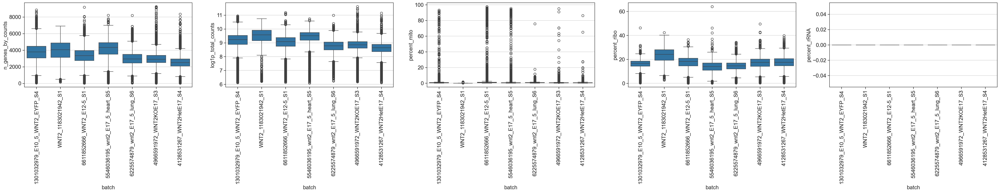

In [6]:
print(adata)
facets = ["n_genes_by_counts", "log1p_total_counts", "percent_mito", "percent_ribo", "percent_rRNA"]
fig, ax = plt.subplots(1,len(facets), figsize=(9 * len(facets),4))
for i in range(0, len(facets)):      
    sns.boxplot(data=adata.obs, y=facets[i],  x="batch", ax=ax[i])
    ax[i].set_xticklabels(labels=ax[i].get_xticklabels(), rotation=90)

print("Median values")
for f in facets:
    print("facet: " + f)
    print("median: " + str(np.median(adata.obs[f])))

### Filter cells/genes

In [7]:
min_genes = np.max([300, np.percentile(adata.obs["n_genes_by_counts"], 5)])
max_genes = np.min([10000, np.percentile(adata.obs["n_genes_by_counts"], 95)])
print("min/max genes: " + str(min_genes) + "/" + str(max_genes))

max_mito_percentage = np.min([15, np.percentile(adata.obs["percent_mito"], 95)])
print("max mito percentage: " + str(max_mito_percentage))

min_cells = int(0.0005 * len(adata.obs.index))
print("min cells expressing gene: " + str(min_cells))

sc.pp.filter_cells(adata, min_genes=min_genes)
sc.pp.filter_cells(adata, max_genes=max_genes)
sc.pp.filter_genes(adata, min_cells=min_cells)

min/max genes: 1342.0/5100.0
max mito percentage: 2.2012182264928777
min cells expressing gene: 24


In [8]:
adata.obs["too_high_mito"] = adata.obs["percent_mito"] > max_mito_percentage
adata.obs["too_high_mito"] = adata.obs["too_high_mito"].astype(str)

### Normalize and log-transform the counts

In [9]:
adata.X = adata.layers["counts_scAR"].copy()
sc.pp.normalize_total(adata, target_sum=1e6, key_added="size_factor", layer=None) #X
sc.pp.log1p(adata, layer=None) #X

### Assign sex based on *Xist* expression

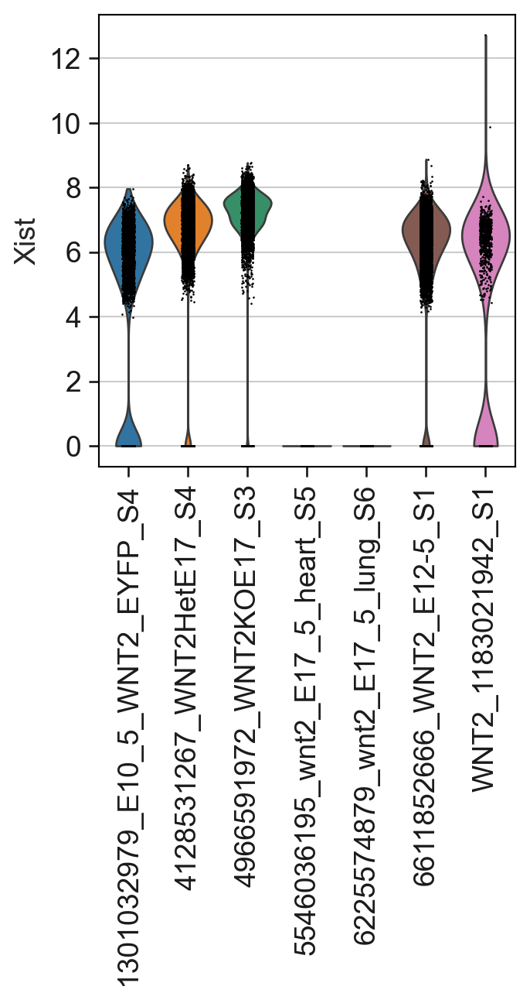

In [10]:
Xist_gene_sybol = "Xist" if organism=="mmusculus" else "XIST"
sc.pl.violin(adata, [Xist_gene_sybol], groupby="batch", rotation=90)
adata.obs["Xist_expression"] = adata.obs_vector(Xist_gene_sybol)
if (mixed_sex_samples):
    adata.obs["sex"] = adata.obs.groupby("batch")["Xist_expression"].transform(lambda x: np.where(x>1, 'XX', 'XY'))
else:
    for b in adata.obs["batch"].unique():
        frac_must_express = 0.6
        a = adata[adata.obs["batch"]==b]
        n_expressing = np.sum(a.obs["Xist_expression"] > 1)
        if (n_expressing > (frac_must_express * a.n_obs)):
            adata.obs.loc[a.obs.index, "sex"] = "XX"
        else:
            adata.obs.loc[a.obs.index, "sex"] = "XY"

### Annotate some genes

In [11]:
def in_ignore_list(g):
    """
    Given a gene symbol `g`, return
    `True` if this gene is any of the following:
        * A mitochondrial gene
        * A ribosomal gene
        * A hemoglobin gene
        * A lncRNA gene
        * An antisense gene
        * A microRNA
        * An uncharacterized/predicted gene
    
    When performing differential expression testing,
    these genes are often not informative for downstream
    studies and so we mark them here in case we would
    like to ignore them.
    
    Parameters
    ----------
    g: str
        The gene symbol to test
    
    Returns
    -------
    bool
        True if g is in any of those categories,
        else False
    
    Usage
    -----
    '''
    >>> in_ignore_list("Gm12941")
    True
    >>> in_ignore_list("Actb")
    False
    >>> adata.var["ignore"] = [in_ignore_list(g) for g in adata.var.index]
    '''
    """
    
    to_ignore = [
        "MT-", "mt-", "RPL", "Rpl", "RPS", "Rps",
        "HBA", "Hba", "HBB", "Hbb", "LINC", "Lnc",
        "RP11", "Rp11", "-AS", "LOC", "n-R5", "-mir",
        "snopsi", "AC0", "XXbac", "Trn", "-DT"
        "-ps", "-ps1", "-ps2", 
        "ROSA", "Gt(ROSA)26Sor"
    ]
    
    regex_patterns_to_ignore = [
        "^Gm[0-9]{3,}", "[0-9]Rik",
        "^AU[0-9]{3,}", "^C[0-9]{1,}orf[0-9]{1,}", 
        "^RP[0-9]{1,}-[0-9]{1,}", "^Rp[0-9]{1,}-[0-9]{1,}",
        "^CT[A-Z]-[0-9]{1,}", "^A[A-Z][0-9]{1,}"
    ]
    
    # first search for brute-forcable substrings
    for x in to_ignore:
        if (x in g):
            return True
        
    # then, if none above are matches, check for complex (regex-needed) substrings
    for pattern in regex_patterns_to_ignore:
        if (re.search(pattern, g)):
            return True
    
    # no matches found
    return False

In [12]:
adata.var["ignore"] = [in_ignore_list(g) for g in adata.var.index]

In [13]:
adata.var.index = [g if (g != "EFYP") else ("EYFP") for g in adata.var.index.tolist()]

## Identify and remove doublets

In [14]:
def calculate_expected_doublet_rate(
    n_cells_loaded=None, 
    n_cells_detected=None, 
    all_info=False
):
    """
    Given the number of cells, 
    returns the expected percentage of cells that
    are doublets (multiplets). 
    
    Parameters
    ----------
    n_cells_loaded: int
        The number of cells loaded into a single 10X lane
    
    n_cells_detected: int
        The number of cells detected (i.e. len(adata.obs))
    
    all_info: bool (default: False)
        When True, returns expected # of cells recovered
        from single 10X lane as well. Changes return type
        from float to dict
        
    Returns
    -------
    one of: 
    
        doublet_rate: float
            Returned when all_info==False
            Value in range [0,100] representing 
            expected doublet rate

        info: (optional) dict with keys ["doublet_rate", "n_cells_loaded", "n_cells_detected"]
            Returned when all_info==True
            dict storing doublet_rate (as above)
            and the number of expected/loaded cells
    
    All data is based on published 10X genomics multiplet rates, 
    see: https://kb.10xgenomics.com/hc/en-us/articles/360001378811-What-is-the-maximum-number-of-cells-that-can-be-profiled-
    """
    
    if ((n_cells_loaded and n_cells_detected)
    or not (n_cells_loaded or n_cells_detected)):
        print("[ERROR] specify exactly one of n_cells_loaded/n_cells_detected")
        return None

    
    n_cells_lane      = np.array([825, 1650, 3300, 4950, 6600, 8250, 9900, 11550, 13200, 14850, 16500])
    multiplet_rate    = np.array([0.4, 0.8, 1.6, 2.4, 3.2, 4.0, 4.8, 5.6, 6.4, 7.2, 8.0])
    n_cells_recovered = np.array([500, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000, 9000, 10000])
    
    
    if (n_cells_detected):
        # given detected number, estimate loading number
        x = n_cells_recovered
        z = n_cells_lane
        a = n_cells_detected
    elif (n_cells_loaded):
        # given loaded number, estimate detected number
        x = n_cells_lane
        z = n_cells_recovered
        a = n_cells_loaded
    y = multiplet_rate
    
    y_gam = LinearGAM(n_splines=10).fit(x, y)
    z_gam = LinearGAM(n_splines=10).fit(x, z)
    
    rate = y_gam.predict(a)[0]
    n_cells_expected = z_gam.predict(a)[0]
    
    if (all_info):
        if (n_cells_detected):
            ret = {"doublet_rate": rate,
                   "n_cells_loaded": n_cells_expected,
                   "n_cells_detected": n_cells_detected}
        elif (n_cells_loaded):
            ret = {"doublet_rate": rate,
                   "n_cells_loaded": n_cells_loaded,
                   "n_cells_detected": n_cells_expected}
    else:
        ret = rate
    return ret

In [15]:
def SOLO_identify_doublets(
    adata,
    batch_key="batch",
    counts_layer="counts_raw"
):
    """
    Builds a SOLO model using scVI-tools for each batch
    of data in adata and updates cell labels with putative
    doublet/singlet annotation. Uses expected doublet rate
    information from 10X chip loading to set cutoffs, and so
    may not be perfectly suited for other applications.
    
    Parameters
    ----------
    
    adata: AnnData
        The anndata object
    
    batch_key: str (default: "batch")
        Column in  adata.obs populated with the cell's 
        original 10X channel (sample) label.
    
    counts_layer: str (default: "counts_raw")
        Key in adata.layers containing the raw gene 
        expression counts. Could use ambient corrected 
        counts or raw counts with slightly different
        performance.
    
    Returns
    -------
    None:
        Updates adata in-place with the following:
        adata.obs["SOLO_predicted_doublet"] -> pd.Series, values ("doublet", "singlet")
        adata.uns["SOLO_percent_doublets"]  -> dict of float (% doublets in sample)
        adata.uns["SOLO_soft_predictions"]  -> dict of pd.DataFrame of doublet probabilities
    """
    
    adata.uns["SOLO_percent_doublets"] = {}
    adata.uns["SOLO_soft_predictions"] = {}
    adata.obs["SOLO_predicted_doublet"] = "unknown"

    print("Preparing to identify doublets...")
    
    # train the base scVI model on the entire dataset first (required)
    bdata = adata.copy()
    scvi.model.SCVI.setup_anndata(bdata, batch_key=batch_key, layer=counts_layer)
    scvi_model = scvi.model.SCVI(bdata, n_latent=30, n_layers=2)
    scvi_model.train(max_epochs=30)
    
    # for each batch, build a SOLO model and call doublets
    for b in bdata.obs[batch_key].unique():
        print("Identifying doublets in batch: " + str(b))
        
        # build and train the SOLO model from a subset of the scVI model
        solo_model = scvi.external.SOLO.from_scvi_model(scvi_model, restrict_to_batch=b)
        try:
            solo_model.train(max_epochs=30)
            soft_predictions = solo_model.predict(soft=True)

            # get the expected doublet rate, using the number of cells in this batch as the prior
            # the set the min/max soft doublet prediction score based on this information
            expected_doublet_rate = calculate_expected_doublet_rate(
                n_cells_detected=len(bdata[bdata.obs[batch_key]==b].obs)
            )
            max_score = np.percentile(soft_predictions["doublet"], 100 - (1.5*expected_doublet_rate))
            min_score = np.percentile(soft_predictions["singlet"], 1.5 * expected_doublet_rate)

            # call doublets using the min/max scores 
            soft_predictions["is_doublet"] = (
                (soft_predictions["doublet"] > max_score) 
              & (soft_predictions["singlet"] < min_score)
            )
            predictions = soft_predictions["is_doublet"].apply(lambda x: "doublet" if x else "singlet")
            idx = [x[:-2] for x in predictions.index.tolist()] # removes added characters in index labels

            # transfer calls and metadata (soft predictions, % doublets) back to the original adata object
            mask = adata.obs[batch_key].isin([b])
            adata.obs.loc[mask, "SOLO_predicted_doublet"] = predictions.values
            adata.uns["SOLO_percent_doublets"][b.replace("/", ".")] = round(
                np.sum(predictions == "doublet") * 100 / len(bdata[bdata.obs[batch_key]==b].obs),
                2
            )
            adata.uns["SOLO_soft_predictions"][b.replace("/", ".")] = soft_predictions
        except Exception as e:
            print("SOLO inference failed for: " + str(b))
            adata.uns["SOLO_percent_doublets"][b.replace("/", ".")] = np.nan
            adata.uns["SOLO_soft_predictions"][b.replace("/", ".")] = None
            print(e)
        
        # clean up
        del solo_model 
    
    # clean up
    del bdata
    del scvi_model
    
    return None

### Select highly variable genes

In [16]:
sc.pp.highly_variable_genes(adata, flavor="cell_ranger", n_top_genes=2000, batch_key="batch")
adata.var.loc[adata.var.index.isin(["SiteA", "SiteB", "tdTomato", "tdTomato_orig", "EYFP", "EFYP"]), "highly_variable"] = False

In [17]:
if (identify_doublets):
    print("Identifying doublets...")
    bdata = adata[:, adata.var["highly_variable"]].copy()
    # call the custom wrapper function for the scvi-tools SOLO model
    SOLO_identify_doublets(bdata)
    
    # print total number of doublets/singlets 
    print(bdata.obs["SOLO_predicted_doublet"].value_counts())
    
    # print doublet percentage for each sample
    for b in bdata.obs["batch"].unique():
        print("Batch: " + str(b.replace("/", ".")) + ": " + str(bdata.uns["SOLO_percent_doublets"][b.replace("/", ".")]) + "% doublets")

    # transfer doublet annotations
    adata.obs["SOLO_predicted_doublet"] = bdata.obs["SOLO_predicted_doublet"]
    
    # remove the doublets
    if (filter_doublets):
        print("Removing doublets...")
        adata = adata[adata.obs["SOLO_predicted_doublet"] == "singlet", :]
    
    del bdata

Identifying doublets...


No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


Preparing to identify doublets...


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 30/30 [01:08<00:00,  2.28s/it, v_num=1, train_loss_step=1.07e+3, train_loss_epoch=1.09e+3]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 30/30 [01:08<00:00,  2.29s/it, v_num=1, train_loss_step=1.07e+3, train_loss_epoch=1.09e+3]
Identifying doublets in batch: 1301032979_E10_5_WNT2_EYFP_S4


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:05<00:00,  5.79it/s, v_num=1, train_loss_step=0.103, train_loss_epoch=0.127]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:05<00:00,  5.72it/s, v_num=1, train_loss_step=0.103, train_loss_epoch=0.127]
Identifying doublets in batch: WNT2_1183021942_S1


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 23.53it/s, v_num=1, train_loss_step=0.102, train_loss_epoch=0.108]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 23.66it/s, v_num=1, train_loss_step=0.102, train_loss_epoch=0.108]
Identifying doublets in batch: 6611852666_WNT2_E12-5_S1


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|██████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:06<00:00,  4.61it/s, v_num=1, train_loss_step=0.0539, train_loss_epoch=0.103]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|██████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:06<00:00,  4.52it/s, v_num=1, train_loss_step=0.0539, train_loss_epoch=0.103]
Identifying doublets in batch: 5546036195_wnt2_E17_5_heart_S5


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:03<00:00,  8.01it/s, v_num=1, train_loss_step=0.249, train_loss_epoch=0.103]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:03<00:00,  8.00it/s, v_num=1, train_loss_step=0.249, train_loss_epoch=0.103]
Identifying doublets in batch: 6225574879_wnt2_E17_5_lung_S6


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:16<00:00,  1.83it/s, v_num=1, train_loss_step=0.307, train_loss_epoch=0.156]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:16<00:00,  1.82it/s, v_num=1, train_loss_step=0.307, train_loss_epoch=0.156]
Identifying doublets in batch: 4966591972_WNT2KOE17_S3


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:10<00:00,  2.79it/s, v_num=1, train_loss_step=0.161, train_loss_epoch=0.127]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:10<00:00,  2.77it/s, v_num=1, train_loss_step=0.161, train_loss_epoch=0.127]
Identifying doublets in batch: 4128531267_WNT2HetE17_S4


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:09<00:00,  3.00it/s, v_num=1, train_loss_step=0.116, train_loss_epoch=0.146]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30/30: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:09<00:00,  3.04it/s, v_num=1, train_loss_step=0.116, train_loss_epoch=0.146]
SOLO_predicted_doublet
singlet    39914
doublet     3787
Name: count, dtype: int64
Batch: 1301032979_E10_5_WNT2_EYFP_S4: 3.77% doublets
Batch: WNT2_1183021942_S1: 0.53% doublets
Batch: 6611852666_WNT2_E12-5_S1: 4.93% doublets
Batch: 5546036195_wnt2_E17_5_heart_S5: 2.14% doublets
Batch: 6225574879_wnt2_E17_5_lung_S6: 13.96% doublets
Batch: 4966591972_WNT2KOE17_S3: 8.83% doublets
Batch: 4128531267_WNT2HetE17_S4: 8.51% doublets
Removing doublets...


## Do the PCA and generate downstream projections

### Initial batch corrected PCA

In [18]:
from harmony import harmonize
sc.tl.pca(adata, svd_solver='arpack', n_comps=50, random_state=0, use_highly_variable=True) 
if (len(adata.obs["batch"].unique()) > 1):
    Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key="batch", random_state=0)
    adata.obsm['X_pca_original'] = adata.obsm["X_pca"]
    adata.obsm["X_pca"] = Z

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
Reach convergence after 8 iteration(s).


### Initial neighborhood construction, UMAP generation, and leiden clustering

n_neighbors=39


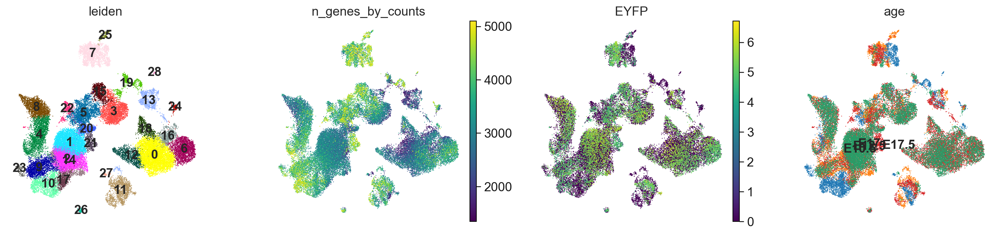

In [19]:
n_neighbors = int(0.2 * np.sqrt(len(adata.obs)))
print("n_neighbors=" + str(n_neighbors))

sc.pp.neighbors(adata, n_neighbors=n_neighbors, random_state=0)
sc.tl.umap(adata, random_state=0, init_pos="spectral", min_dist=0.75)

# Clustering
sc.tl.leiden(adata, resolution=1, random_state=0)

# Plot it
sc.pl.umap(adata, color=["leiden", "n_genes_by_counts", "EYFP", "age"], legend_loc="on data", frameon=False)

### Identify small clusters of epithelial/immune/chondroctye cells to remove

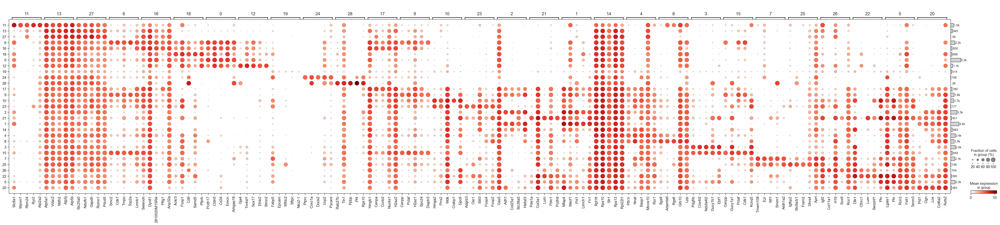

In [20]:
factor = "leiden"

sc.tl.rank_genes_groups(adata, factor, pts=True, method='wilcoxon')

fig = sc.pl.rank_genes_groups_dotplot(
    adata, 
    key="rank_genes_groups",
    n_genes=5, 
    dendrogram=True,
    groupby=factor,
    swap_axes=False, 
    return_fig=True,
)
fig.add_totals(color="lightgrey").show()

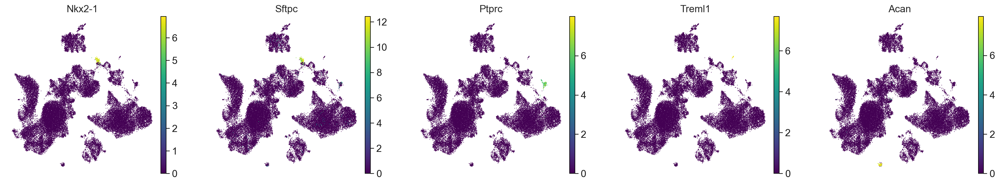

In [21]:
sc.pl.umap(adata, color=["Nkx2-1", "Sftpc", "Ptprc", "Treml1", "Acan"], frameon=False, ncols=5)

In [22]:
mask  = adata.obs_vector("Nkx2-1")  < 1
mask &= adata.obs_vector("Ptprc")  < 1
mask &= adata.obs_vector("Treml1") < 1
mask &= adata.obs_vector("Acan")   < 1
adata = adata[mask]

### Use scVI to generate refined batch- and covariate-corrected projection

This requires a GPU for reasonable inference speeds; skip and/or use the paper's UMAP coordinates as-needed.

In [23]:
bdata = ad.AnnData(obs=adata.obs, var=adata.var, X=adata.layers["counts_raw"].copy())
bdata.layers["counts"] = bdata.X.copy()
scvi.model.SCVI.setup_anndata(
    bdata,
    batch_key="batch", 
    layer="counts",
    categorical_covariate_keys=["sex", "age"],
    continuous_covariate_keys=["log1p_total_counts"]
)
scvi_model = scvi.model.SCVI(bdata)
scvi_model.train(max_epochs=50)
bdata.obsm["X_scVI"] = scvi_model.get_latent_representation()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 50/50: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 50/50 [05:04<00:00,  6.06s/it, v_num=1, train_loss_step=8.04e+3, train_loss_epoch=8.06e+3]

`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50/50: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 50/50 [05:04<00:00,  6.09s/it, v_num=1, train_loss_step=8.04e+3, train_loss_epoch=8.06e+3]


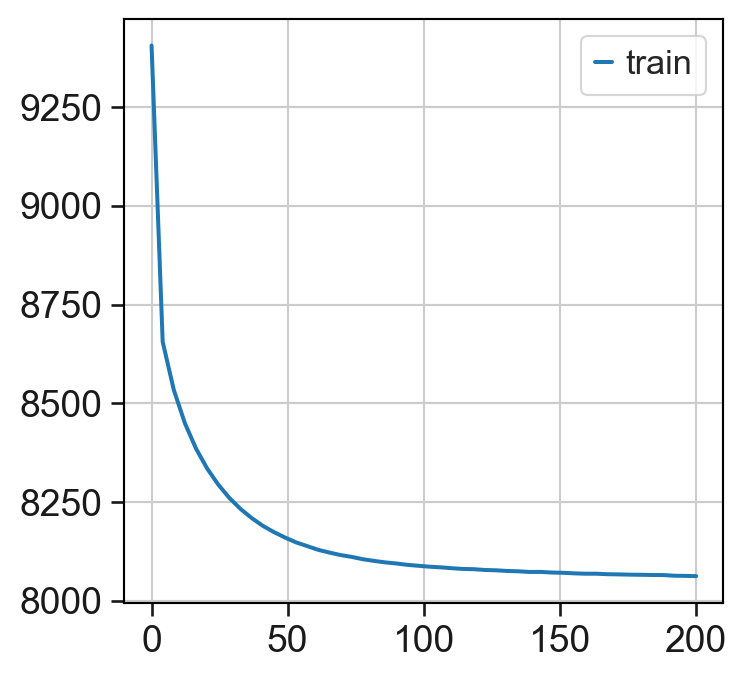

In [24]:
elbo_train = scvi_model.history["train_loss_epoch"]
x = np.linspace(0, 200, (len(elbo_train)))
plt.plot(x, elbo_train, label="train")
plt.legend()

In [25]:
adata.obsm["X_scVI"] = bdata.obsm["X_scVI"]

### Perform neighborhood construction, UMAP generation, and leiden clustering

n_neighbors=39


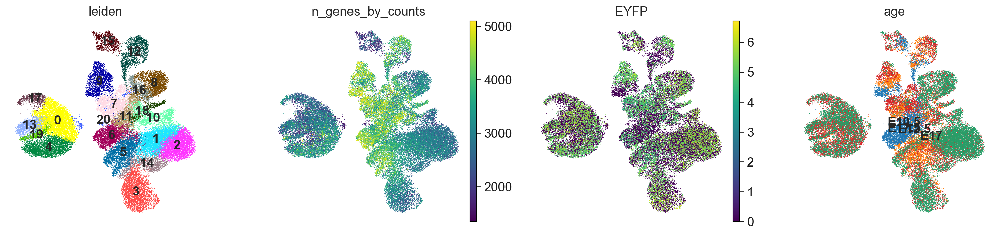

In [26]:
n_neighbors = int(0.2 * np.sqrt(len(adata.obs)))
print("n_neighbors=" + str(n_neighbors))

sc.pp.neighbors(adata, n_neighbors=n_neighbors, random_state=0, use_rep="X_scVI")
sc.tl.umap(adata, random_state=0, init_pos="spectral", min_dist=0.8)

# Clustering
sc.tl.leiden(adata, resolution=1, random_state=0)

# Plot it
sc.pl.umap(adata, color=["leiden", "n_genes_by_counts", "EYFP", "age"], legend_loc="on data", frameon=False)

### Load in the paper's UMAP coordinates as initial positions

This will generate a UMAP layout similar to that shown in the paper, as changes to parameters/software versions may introduce variance in the final layout.

In [28]:
bdata = ad.read_h5ad("../data/adata_zenodo.h5ad")
bdata = bdata[bdata.obs.index.isin(adata.obs.index)]

In [ ]:
mask = adata.obs.index.isin(bdata.obs.index)
adata.obsm["X_umap_init"] = np.zeros_like(adata.obsm["X_umap"]) #adata.obsm["X_umap"].copy().astype(float)
np.place(
    adata.obsm["X_umap_init"],
    np.array([mask, mask]).T, 
    bdata.obsm["X_umap"]
)

n_neighbors=39


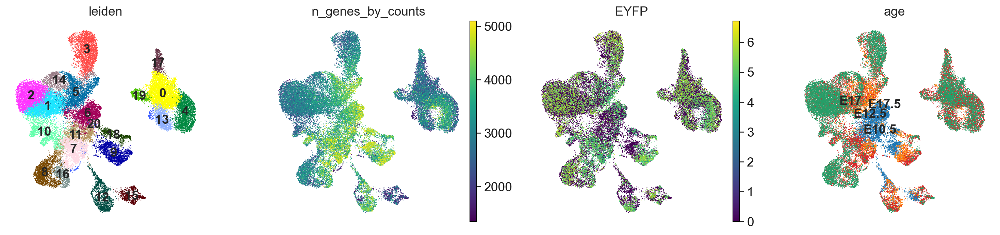

In [34]:
n_neighbors = int(0.2 * np.sqrt(len(adata.obs)))
print("n_neighbors=" + str(n_neighbors))

sc.pp.neighbors(adata, n_neighbors=n_neighbors, random_state=0, use_rep="X_scVI")
sc.tl.umap(adata, random_state=0, init_pos="X_umap_init", min_dist=0.5)

# Clustering
sc.tl.leiden(adata, resolution=1, random_state=0)

# Plot it
sc.pl.umap(adata, color=["leiden", "n_genes_by_counts", "EYFP", "age"], legend_loc="on data", frameon=False)

## Save/load the data

In [27]:
adata.write_h5ad("adata_processed.h5ad", compression="gzip")

n_neighbors=39


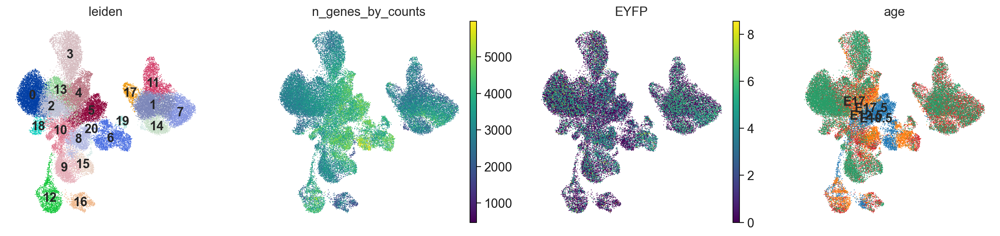

In [5]:
n_neighbors = int(0.2 * np.sqrt(len(adata.obs)))
print("n_neighbors=" + str(n_neighbors))

sc.pp.neighbors(adata, n_neighbors=n_neighbors, random_state=0)
sc.tl.umap(adata, random_state=0, init_pos="spectral", min_dist=0.75)

# Clustering
sc.tl.leiden(adata, resolution=1, random_state=0)

# Plot it
sc.pl.umap(adata, color=["leiden", "n_genes_by_counts", "EYFP", "age"], legend_loc="on data", frameon=False)

### Score cell cycle genes

... storing 'phase' as categorical


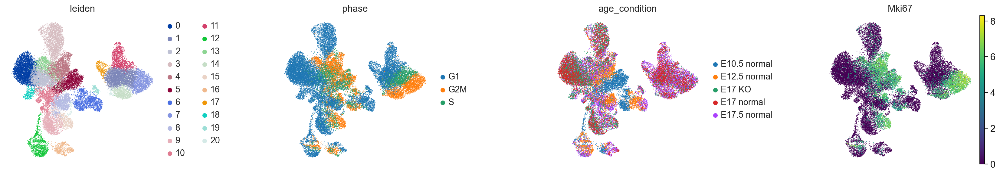

In [22]:
cell_cycle_gene_df = pd.read_csv(
    "./data/cell_cycle_genes.csv",
    sep=",",
    index_col=1
).dropna()

g2m_genes = cell_cycle_gene_df[cell_cycle_gene_df["phase"]=="G2/M"]["mmusculus_symbol"].tolist()
s_genes   = cell_cycle_gene_df[cell_cycle_gene_df["phase"]=="S"]["mmusculus_symbol"].tolist()

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

sc.pl.umap(adata, color=["leiden", "phase", "age_condition", "Mki67"], cmap=continuous_cmap, wspace=0.6, frameon=False)

## Figure 1: Overview plots

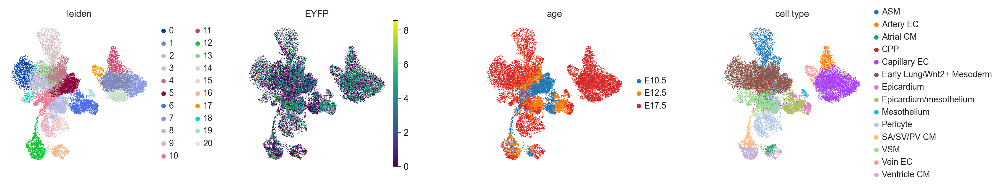

In [147]:
sc.pl.umap(adata[adata.obs["age"]!="E17"], color=["leiden", "EYFP", "age", "cell type"], wspace=0.45, frameon=False, save="_paper_broad_overview.svg")

1it [00:01,  1.39s/it]


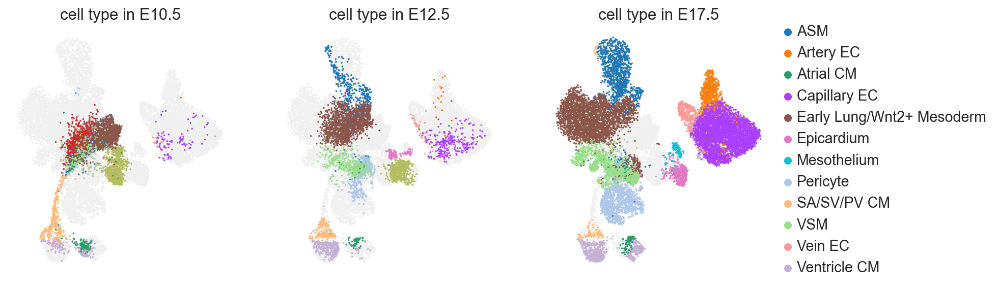

In [144]:
fig = split_plot_umap(adata[adata.obs["age"]!="E17"], "age", ["cell type"], size=10, frameon=False)
fig.savefig("figures/umap_paper_celltype_splitby_age.svg", dpi=300)

1it [00:00,  1.21it/s]


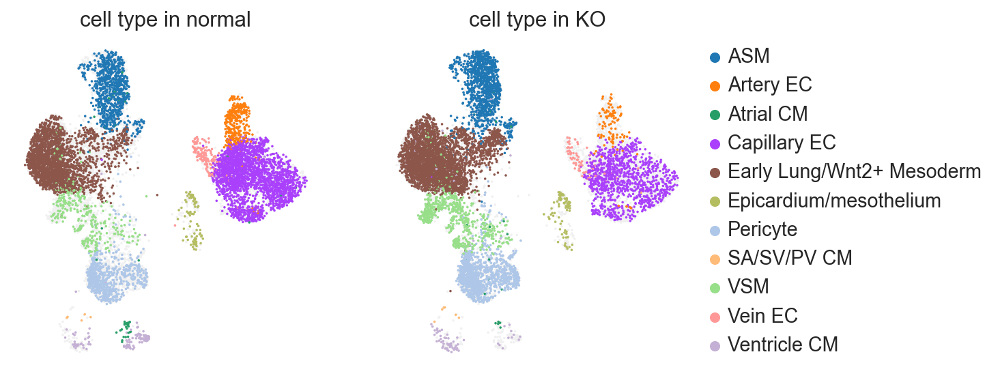

In [145]:
adata.obs["condition"].cat.reorder_categories(["normal", "KO"], inplace=True)
fig = split_plot_umap(adata[adata.obs["age"]=="E17"], "condition", ["cell type"], size=10, frameon=False)
fig.savefig("figures/umap_paper_celltype_splitby_KO.svg", dpi=300)

In [139]:
factor = "leiden"
min_lfc = 1.5
min_in_group = 0.5
max_out_group = 0.35
n_top_genes = 3

sc.tl.dendrogram(adata, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(adata, factor, pts=True, method='t-test_overestim_var')
sc.tl.filter_rank_genes_groups(
    adata, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group, 
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group,
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_dotplot(
    adata, 
    key="rank_genes_groups_filtered",
    n_genes=n_top_genes, 
    dendrogram=True, 
    groupby=factor,
    title=factor, 
    swap_axes=False, 
    return_fig=True
)
fig.savefig("figures/dotplot_paper_leiden_markers.svg")

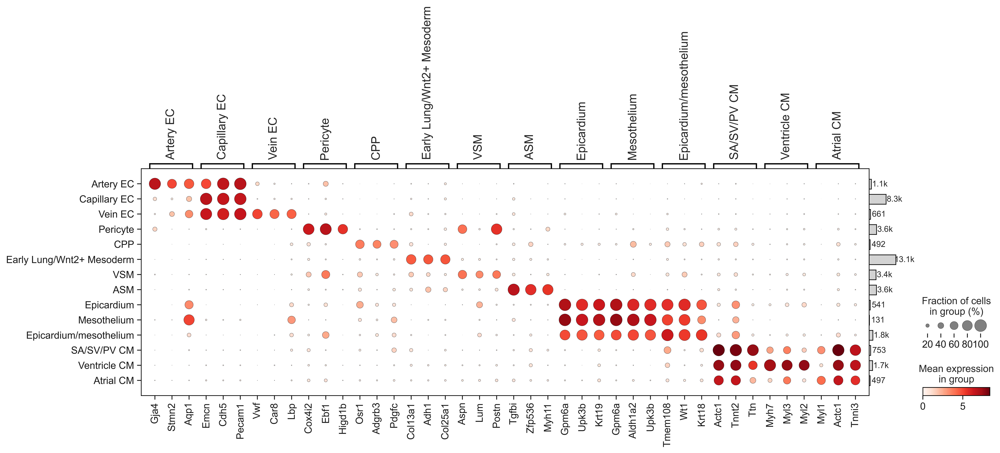

In [140]:
factor = "cell type"
min_lfc = 2
min_in_group = 0.5
max_out_group = 0.15
n_top_genes = 3

a = adata.copy()
sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(a, factor, pts=True, method='t-test_overestim_var')
sc.tl.filter_rank_genes_groups(
    a, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group, 
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group, 
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_dotplot(
    a, 
    key="rank_genes_groups_filtered",
    n_genes=n_top_genes, 
    dendrogram=True, 
    groupby=factor,
    swap_axes=False, 
    return_fig=True
)
fig.add_totals(color="lightgrey").savefig("figures/dotplot_paper_celltype_markers.svg")
del a

categories: ASM, Artery EC, Atrial CM, etc.
var_group_labels: Artery EC, Capillary EC, Vein EC, etc.


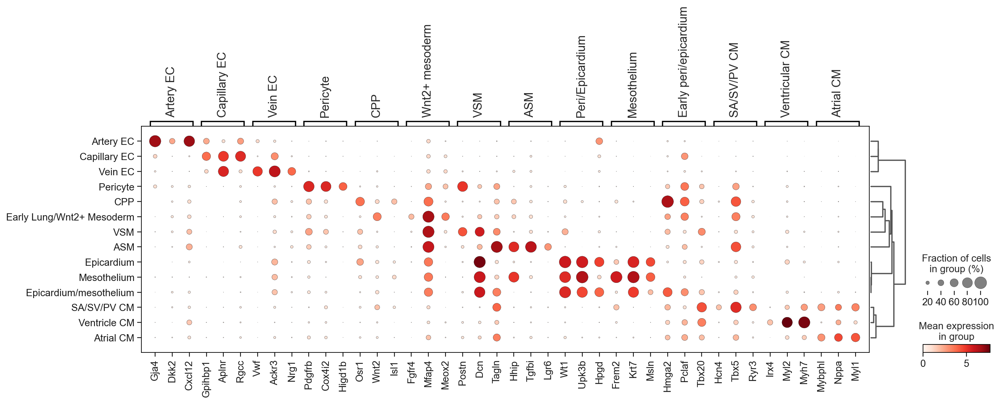

In [4]:
markers = {
    "Artery EC":             ["Gja4", "Dkk2", "Cxcl12"],
    "Capillary EC" :         ["Gpihbp1", "Aplnr", "Rgcc"],
    "Vein EC":               ["Vwf", "Ackr3", "Nrg1"],
    "Pericyte":              ["Pdgfrb", "Cox4i2", "Higd1b"],
    "CPP":                   ["Osr1", "Wnt2", "Isl1"],
    "Wnt2+ mesoderm":        ["Fgfr4", "Mfap4", "Meox2"],
    "VSM":                   ["Postn", "Dcn", "Tagln"],
    "ASM":                   ["Hhip", "Tgfbi", "Lgr6"],
    "Peri/Epicardium":       ["Wt1", "Upk3b", "Hpgd"],
    "Mesothelium":           ["Frem2", "Krt7", "Msln"],
    "Early peri/epicardium": ["Hmga2", "Pclaf", "Tbx20"],
    "SA/SV/PV CM":           ["Hcn4", "Tbx5", "Ryr3"],
    "Ventricular CM":        ["Irx4", "Myl2", "Myh7"],
    "Atrial CM":             ["Mybphl", "Nppa", "Myl1"],
}

sc.pl.dotplot(adata[adata.obs["age"]!="E17"], markers, groupby="cell type", dendrogram=True, save="dotplot_paper_all_celltype_canonical_markers.svg")

## Figure 2: Heart cells at E17.5

In [108]:
a.write_h5ad("adata_heart_processed.h5ad", compression="gzip")

In [2]:
a = ad.read_h5ad("adata_heart_processed.h5ad")

In [ ]:
mask = (adata.obs["age"] == "E17.5") & (adata.obs["organ"] == "heart")
a = adata[mask, ~adata.var["ignore"]].copy()
a

In [ ]:
#n_neighbors = int(0.2 * np.sqrt(len(a.obs)))
n_neighbors = 20
print("n_neighbors=" + str(n_neighbors))

sc.pp.neighbors(a, n_neighbors=n_neighbors, random_state=0, use_rep="X_pca")
sc.tl.umap(a, random_state=0, init_pos="spectral", min_dist=0.8)

# Clustering
sc.tl.leiden(a, resolution=0.45, random_state=0)

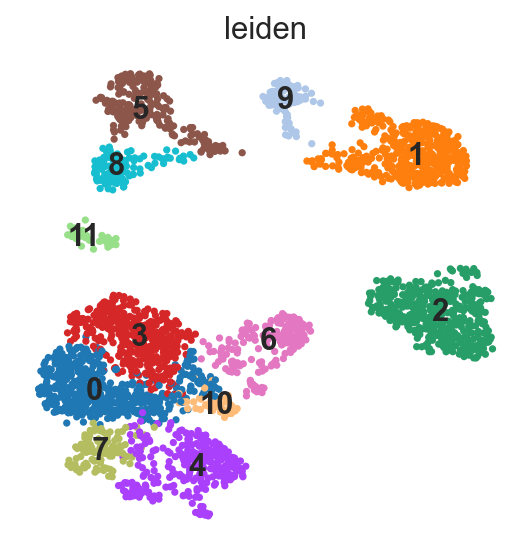

In [98]:
sc.pl.umap(a, color=["leiden"], legend_loc="on data", frameon=False, save="_paper_heart_leiden.svg")

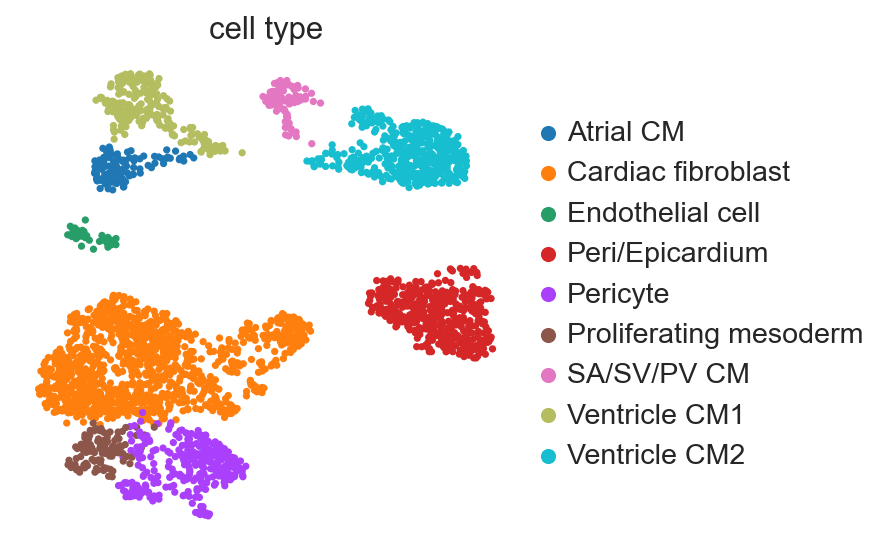

In [107]:
factor = "cell type"
a.obs[factor] = a.obs[factor].astype(str)

a.obs.loc[a.obs["leiden"].isin(["0", "3", "6", "10"]), factor] = "Cardiac fibroblast"
a.obs.loc[a.obs["leiden"].isin(["7"]), factor]  = "Proliferating mesoderm"
a.obs.loc[a.obs["leiden"].isin(["4"]), factor]  = "Pericyte"
a.obs.loc[a.obs["leiden"].isin(["11"]), factor] = "Endothelial cell"
a.obs.loc[a.obs["leiden"].isin(["2"]), factor]  = "Peri/Epicardium"
a.obs.loc[a.obs["leiden"].isin(["5"]), factor]  = "Ventricle CM1"
a.obs.loc[a.obs["leiden"].isin(["1"]), factor]  = "Ventricle CM2"
a.obs.loc[a.obs["leiden"].isin(["9"]), factor]  = "SA/SV/PV CM"
a.obs.loc[a.obs["leiden"].isin(["8"]), factor]  = "Atrial CM"

sc.pl.umap(a, color=["cell type"], frameon=False, save="_paper_heart_cell_type.svg")

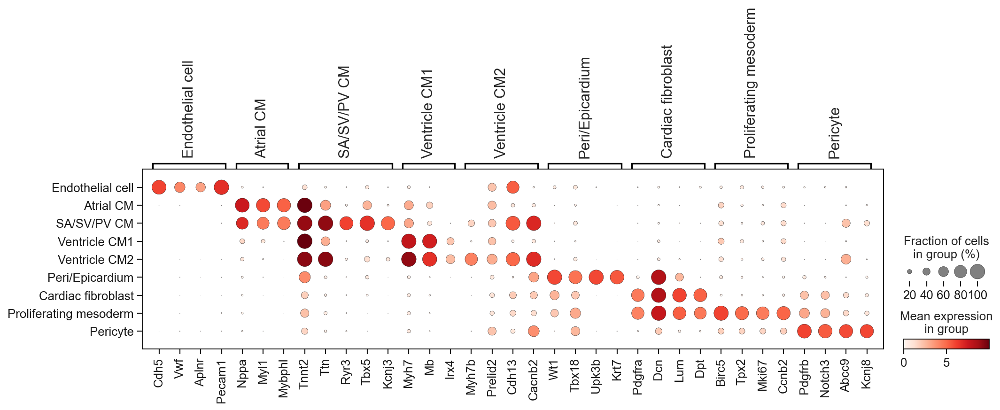

In [106]:
markers = {
    "Endothelial cell":          ["Cdh5", "Vwf", "Aplnr", "Pecam1"],
    "Atrial CM":                 ["Nppa", "Myl1", "Mybphl"],
    "SA/SV/PV CM":               ["Tnnt2", "Ttn", "Ryr3", "Tbx5", "Kcnj3"],
    "Ventricle CM1":             ["Myh7", "Mb", "Irx4"],
    "Ventricle CM2":             ["Myh7b", "Prelid2", "Cdh13", "Cacnb2"],
    "Peri/Epicardium":           ["Wt1", "Tbx18", "Upk3b", "Krt7"],
    "Cardiac fibroblast":        ["Pdgfra", "Dcn", "Lum", "Dpt"],
    "Proliferating mesoderm":    ["Birc5", "Tpx2", "Mki67", "Ccnb2"],
    "Pericyte":                  ["Pdgfrb", "Notch3", "Abcc9", "Kcnj8"],
}

a.obs["cell type"] = a.obs["cell type"].cat.reorder_categories(markers.keys())

sc.tl.dendrogram(a, groupby="cell type", optimal_ordering=True)

sc.pl.dotplot(
    a, 
    markers, 
    groupby="cell type",
    dendrogram=False,
    save="paper_heart_cell_type_canonical_markers_no_dendrogram.svg"
)

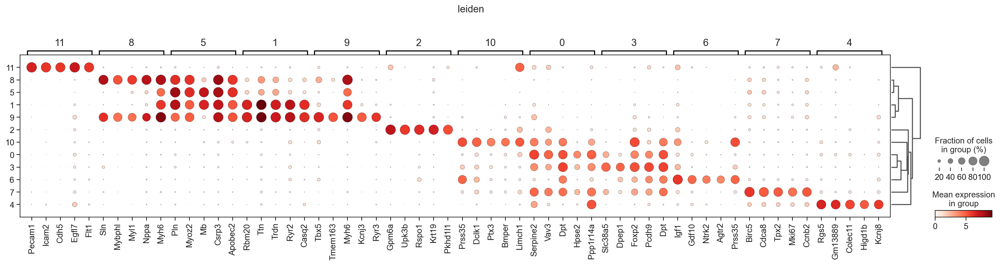

In [53]:
factor = "leiden"
min_lfc = 1.5
min_in_group = 0.5
max_out_group = 0.35
n_top_genes = 5

sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(a, factor, pts=True, method='t-test_overestim_var')
sc.tl.filter_rank_genes_groups(
    a, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group,
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group,
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_dotplot(
    a, 
    key="rank_genes_groups_filtered",
    n_genes=n_top_genes, 
    dendrogram=True, groupby=factor,
    title=factor,
    swap_axes=False,
    return_fig=True
)
fig.show()
#fig.savefig("figures/dotplot_paper_heart_leiden_markers.svg")

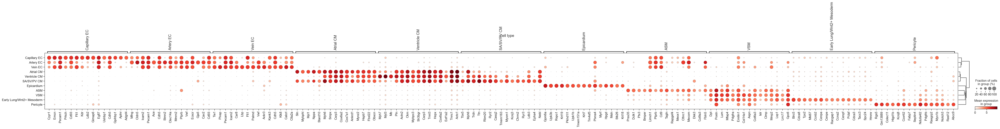

In [117]:
factor = "cell type"
min_lfc = 1.5
min_in_group = 0.5
max_out_group = 0.35
n_top_genes = 15

sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(a, factor, pts=True, method='t-test_overestim_var')
sc.tl.filter_rank_genes_groups(
    a, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group,
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group,
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_dotplot(
    a, 
    key="rank_genes_groups_filtered",
    n_genes=n_top_genes, 
    dendrogram=True, 
    groupby=factor,
    title=factor, 
    swap_axes=False, 
    return_fig=True
)
fig.savefig("figures/dotplot_paper_heart_celltype_markers.svg")

### Supplemental figure for CM1 vs. CM2 populations

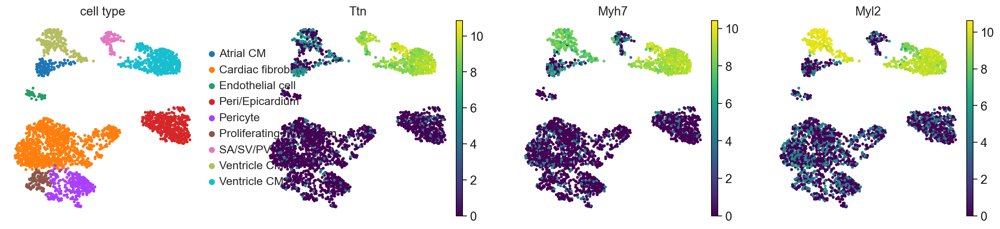

In [18]:
genes_of_interest = ["Ttn", "Myh7", "Myl2"]
sc.pl.umap(a, color = ["cell type"] + genes_of_interest, frameon=False, sort_order=False, save="_supplemental_CM1_CM2_markers.svg")

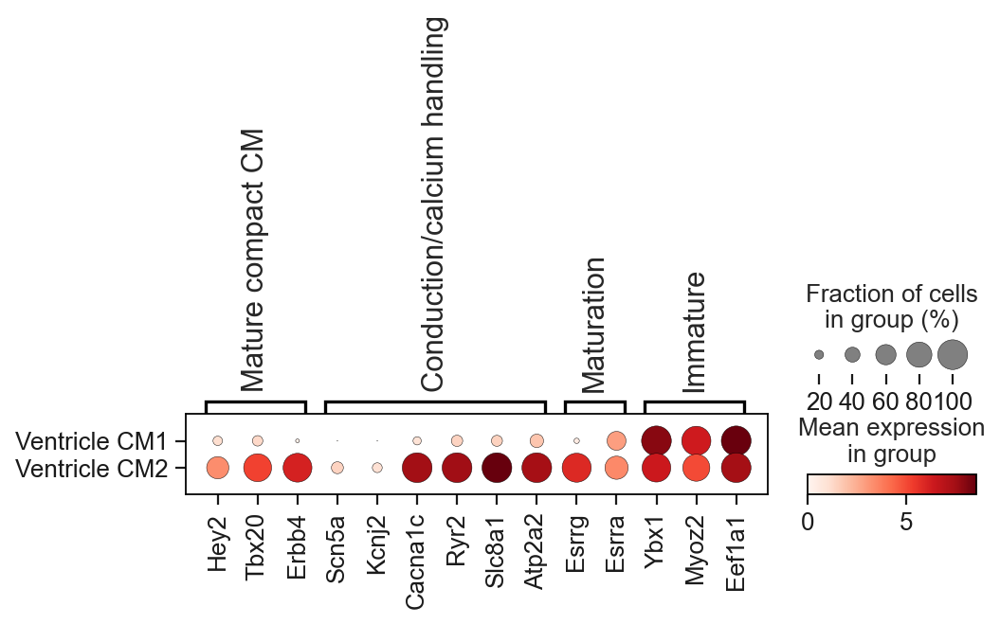

In [16]:
genes_of_interest = {
    "Mature compact CM": ["Hey2", "Tbx20", "Erbb4"],
    "Conduction/calcium handling": ["Scn5a", "Kcnj2", "Cacna1c", "Ryr2", "Slc8a1", "Atp2a2"],
    "Maturation": ["Esrrg", "Esrra"],
    "Immature": ["Ybx1", "Myoz2", "Eef1a1"]
}

sc.pl.dotplot(
    a[a.obs["cell type"].isin(["Ventricle CM1", "Ventricle CM2"])],
    genes_of_interest,
    groupby = "cell type",
    vmin = 0,
    swap_axes = False,
    save = "_supplemental_CM1_CM2_selected_markers.svg"
)

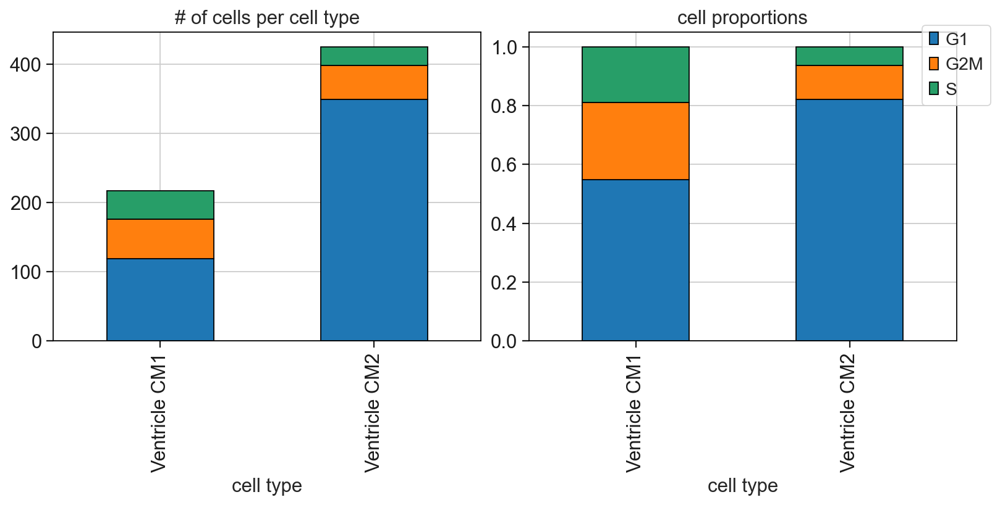

In [17]:
cell_mask = a.obs["cell type"].isin(["Ventricle CM1", "Ventricle CM2"])
b = a[cell_mask,:]
fig = plot_batch_cluster_percent(
    b,
    factor_to_plot = "phase",
    split_by = "cell type"
)
fig.savefig("figures/barplot_supplemental_CM1_CM2_phase.svg")
del b

### Transfer annotations back to main adata object

In [ ]:
mask = adata.obs.index.isin(a.obs.index)

In [49]:
organ = "heart"

adata.obs[organ + "_celltype"] = np.nan
adata.obs.loc[mask, organ + "_celltype"] = a.obs["cell type"]

adata.obs[organ + "_leiden"] = np.nan
adata.obs.loc[mask, organ + "_leiden"] = a.obs["leiden"]

In [50]:
adata.obsm["X_umap_" + organ] = adata.obsm["X_umap"].copy().astype(float)
np.place(
    adata.obsm["X_umap_" + organ], 
    np.array([mask, mask]).T, 
    a.obsm["X_umap"]
)

In [ ]:
b = adata[mask].copy()
b.obsm["X_umap"] = b.obsm["X_umap_" + organ]
sc.pl.umap(b, color=[organ + "_celltype", organ + "_leiden"], frameon=False, wspace=0.55)
del b

## Figure 3: Lung cells at E17.5

In [ ]:
mask = (adata.obs["age"] == "E17.5") & (adata.obs["organ"] == "lung")
a = adata[mask, ~adata.var["ignore"]].copy()
del a.uns["leiden_colors"]
a

In [39]:
def rotate_matrix(coords, angle_in_degrees):
    """
    Given a 2D matrix (np.ndarray) and an angle
    in degrees, return the 2D matrix after rotation.
    """
    theta = np.radians(angle_in_degrees)
    rot = np.array(((np.cos(theta), -np.sin(theta)), (np.sin(theta), np.cos(theta))))
    ret = coords @ rot
    return ret

n_neighbors=20


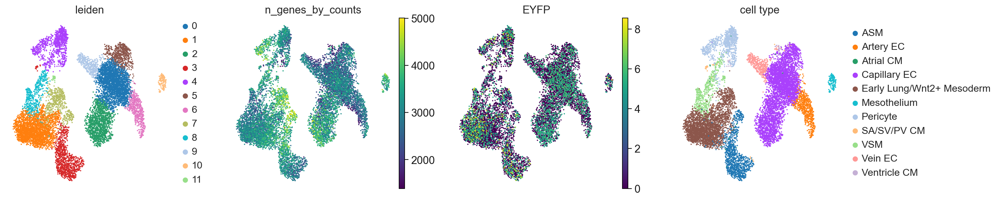

In [40]:
#n_neighbors = int(0.2 * np.sqrt(len(a.obs)))
n_neighbors = 20
print("n_neighbors=" + str(n_neighbors))

sc.pp.neighbors(a, n_neighbors=n_neighbors, random_state=0, use_rep="X_pca")
# 3
sc.tl.umap(a, random_state=3, init_pos="spectral", min_dist=0.8)
a.obsm["X_umap"] = rotate_matrix(a.obsm["X_umap"], 180)

# Clustering
sc.tl.leiden(a, resolution=0.45, random_state=0)

# Plot it
sc.pl.umap(a, color=["leiden", "n_genes_by_counts", "EYFP", "cell type"], frameon=False)

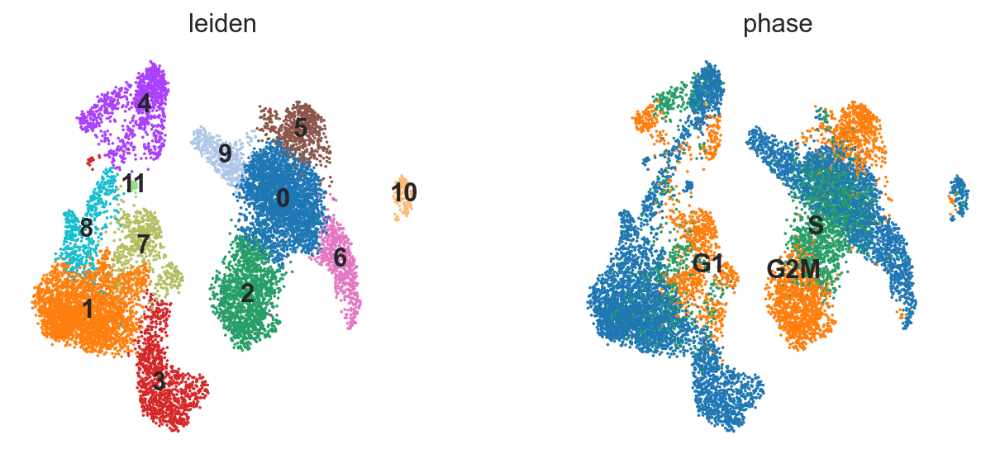

In [41]:
sc.pl.umap(a, color=["leiden", "phase"], legend_loc="on data", frameon=False, save="_paper_lung_leiden.svg")

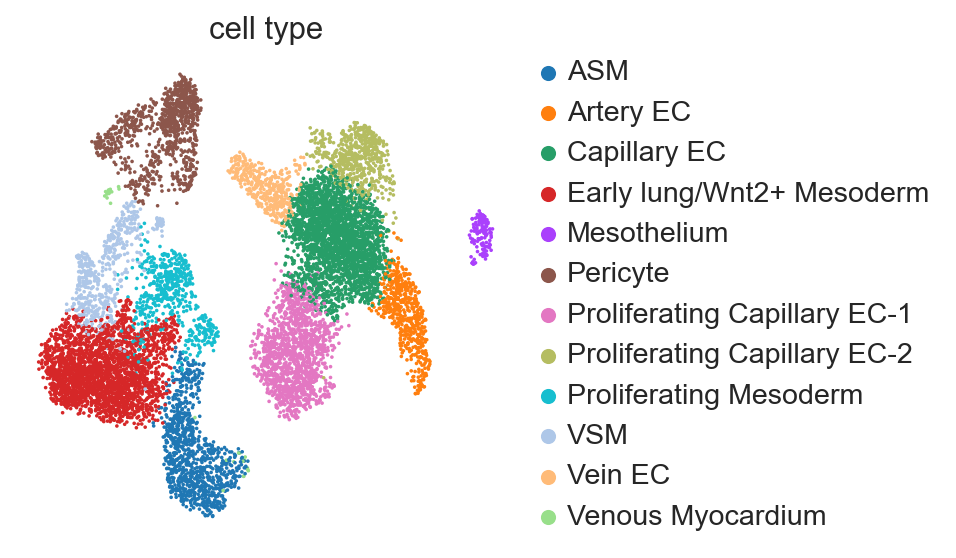

In [48]:
factor = "cell type"
a.obs[factor] = a.obs[factor].astype(str)

a.obs.loc[a.obs["leiden"].isin(["0"]), factor] = "Capillary EC"
a.obs.loc[a.obs["leiden"].isin(["2"]), factor] = "Proliferating Capillary EC-1"
a.obs.loc[a.obs["leiden"].isin(["5"]), factor] = "Proliferating Capillary EC-2"
a.obs.loc[a.obs["leiden"].isin(["6"]), factor] = "Artery EC"
a.obs.loc[a.obs["leiden"].isin(["9"]), factor] = "Vein EC"
a.obs.loc[a.obs["leiden"].isin(["1"]), factor] = "Early lung/Wnt2+ Mesoderm"
a.obs.loc[a.obs["leiden"].isin(["4"]), factor] = "Pericyte"
a.obs.loc[a.obs["leiden"].isin(["8"]), factor] = "VSM"
a.obs.loc[a.obs["leiden"].isin(["7"]), factor] = "Proliferating Mesoderm"
a.obs.loc[a.obs["leiden"].isin(["3"]), factor] = "ASM"
a.obs.loc[a.obs["leiden"].isin(["10"]), factor] = "Mesothelium"
a.obs.loc[a.obs["leiden"].isin(["3"]) & (a.obs_vector("Tnnt2")>1), factor] = "Venous Myocardium"

#sc.pl.umap(a, color=["cell type"], frameon=False, save="_paper_lung_cell_type.svg")
sc.pl.umap(a, color=["cell type"], frameon=False)

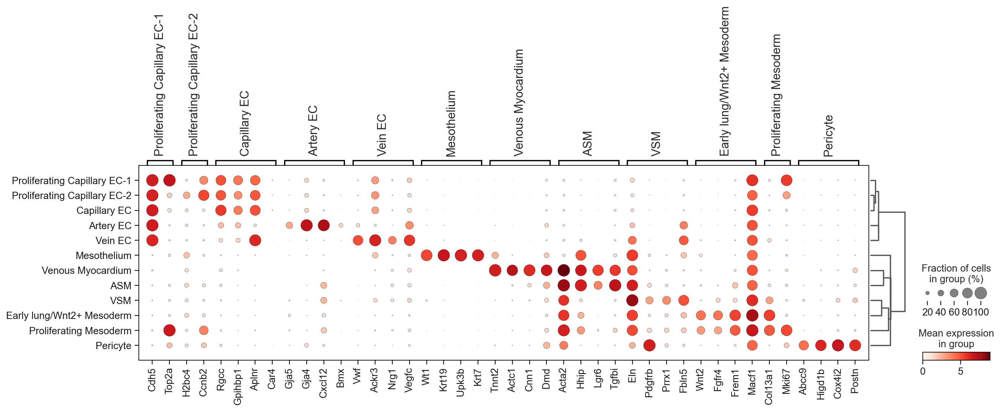

In [13]:
markers = {
    "ASM":                          ["Acta2", "Hhip", "Lgr6", "Tgfbi"],
    "VSM":                          ["Eln", "Pdgfrb", "Prrx1", "Fbln5"],
    "Early lung/Wnt2+ Mesoderm":    ["Wnt2", "Fgfr4", "Frem1", "Macf1"],
    "Mesothelium":                  ["Wt1", "Krt19", "Upk3b", "Krt7"],
    "Capillary EC":                 ["Rgcc", "Gpihbp1", "Aplnr", "Car4"],
    "Artery EC":                    ["Gja5", "Gja4", "Cxcl12", "Bmx"],
    "Vein EC":                      ["Vwf", "Ackr3", "Nrg1", "Vegfc"],
    "Pericyte":                     ["Abcc9", "Higd1b", "Cox4i2", "Postn"],
    "Venous Myocardium":            ["Tnnt2", "Actc1", "Cnn1", "Dmd"],
    "Proliferating Mesoderm":       ["Col13a1", "Mki67"],
    "Proliferating Capillary EC-1": ["Cdh5", "Top2a"],
    "Proliferating Capillary EC-2": ["H2bc4", "Ccnb2"],

}
sc.tl.dendrogram(a, groupby="cell type", optimal_ordering=True, linkage_method="centroid")
sc.pl.dotplot(
    a, 
    markers, 
    groupby="cell type",
    dendrogram=True,
    save="paper_lung_cell_type_canonical_markers.svg"
)

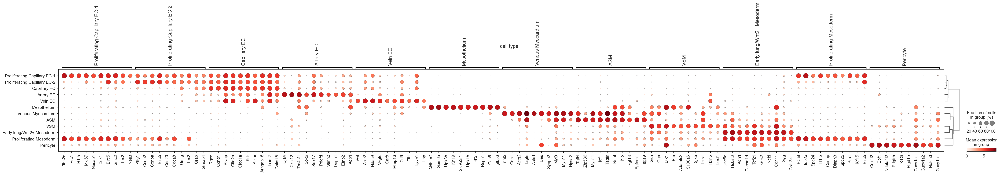

In [162]:
factor = "cell type"
min_lfc = 1.5
min_in_group = 0.5
max_out_group = 0.35
n_top_genes = 10

sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(a, factor, pts=True, method='t-test_overestim_var')
sc.tl.filter_rank_genes_groups(
    a, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group,
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group,
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_dotplot(
    a, 
    key="rank_genes_groups_filtered",
    n_genes=n_top_genes,
    dendrogram=True,
    groupby=factor,
    title=factor,
    swap_axes=False,
    return_fig=True
)
fig.savefig("figures/dotplot_paper_lung_celltype_markers.svg")

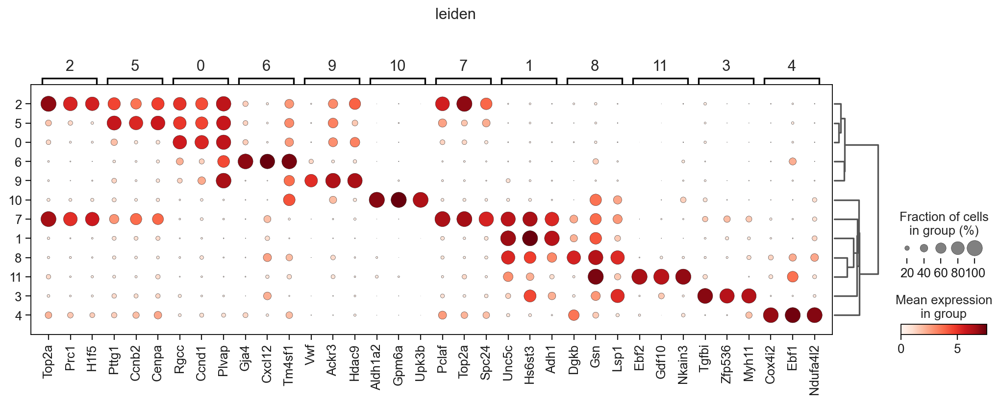

In [43]:
factor = "leiden"
min_lfc = 1.5
min_in_group = 0.5
max_out_group = 0.35
n_top_genes = 3

sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(a, factor, pts=True, method='t-test_overestim_var')
sc.tl.filter_rank_genes_groups(a, key_added='rank_genes_groups_filtered', 
                               min_in_group_fraction=min_in_group, min_fold_change=min_lfc,
                               max_out_group_fraction=max_out_group, compare_abs=False)

fig = sc.pl.rank_genes_groups_dotplot(a, key="rank_genes_groups_filtered",
                                      n_genes=n_top_genes, dendrogram=True, groupby=factor,
                                      title=factor, swap_axes=False, return_fig=True)
#fig.show()
fig.savefig("figures/dotplot_paper_lung_leiden_markers.svg")

### Add annotations back to main adata object

In [ ]:
mask = adata.obs.index.isin(a.obs.index)
mask

In [49]:
organ = "lung"

adata.obs[organ + "_celltype"] = np.nan
adata.obs.loc[mask, organ + "_celltype"] = a.obs["cell type"]

adata.obs[organ + "_leiden"] = np.nan
adata.obs.loc[mask, organ + "_leiden"] = a.obs["leiden"]

In [50]:
adata.obsm["X_umap_" + organ] = adata.obsm["X_umap"].copy().astype(float)
np.place(
    adata.obsm["X_umap_" + organ], 
    np.array([mask, mask]).T, 
    a.obsm["X_umap"]
)

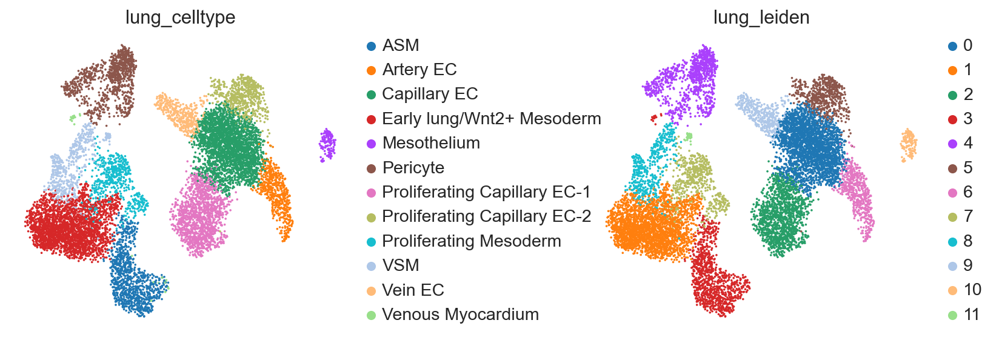

In [51]:
b = adata[mask].copy()
b.obsm["X_umap"] = b.obsm["X_umap_" + organ]
sc.pl.umap(b, color=[organ + "_celltype", organ + "_leiden"], frameon=False, wspace=0.55)
del b

## Figure 4: Trajectory inference at E10.5

In [ ]:
mask = (adata.obs["age"] == "E10.5")
a = adata[mask, ~adata.var["ignore"]].copy()
del a.uns["leiden_colors"]
a

### Model data with scVI to remove effect of cell cycle 
(strong covariate here - CPPs split into two phases)

In [34]:
bdata = ad.AnnData(obs=a.obs, var=a.var, X=a.layers["counts_raw"].copy())
bdata.layers["counts"] = bdata.X.copy()
scvi.model.SCVI.setup_anndata(
    bdata, 
    batch_key="batch", 
    layer="counts",
    categorical_covariate_keys=["phase"],
    continuous_covariate_keys=["log1p_total_counts"]
)
scvi_model = scvi.model.SCVI(bdata)
scvi_model.train(max_epochs=100)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 100/100: 100%|██████████████████████████████████████████████████████████████████████████████████| 100/100 [00:54<00:00,  1.89it/s, loss=9.09e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████████████████████████████████████████████████████████████████████████████| 100/100 [00:54<00:00,  1.84it/s, loss=9.09e+03, v_num=1]


In [35]:
a.obsm["X_scVI"] = scvi_model.get_latent_representation()

n_neighbors=20


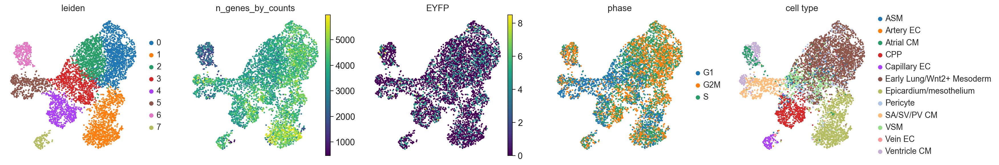

In [77]:
#n_neighbors = int(0.2 * np.sqrt(len(a.obs)))
n_neighbors = 20
print("n_neighbors=" + str(n_neighbors))

sc.pp.neighbors(a, n_neighbors=n_neighbors, random_state=0, use_rep="X_scVI")
sc.tl.umap(a, random_state=0, init_pos="spectral", min_dist=1, spread=1.75)

# Clustering
sc.tl.leiden(a, resolution=0.75, random_state=0)

# Plot it
sc.pl.umap(a, color=["leiden", "n_genes_by_counts", "EYFP", "phase", "cell type"], frameon=False, ncols=5)

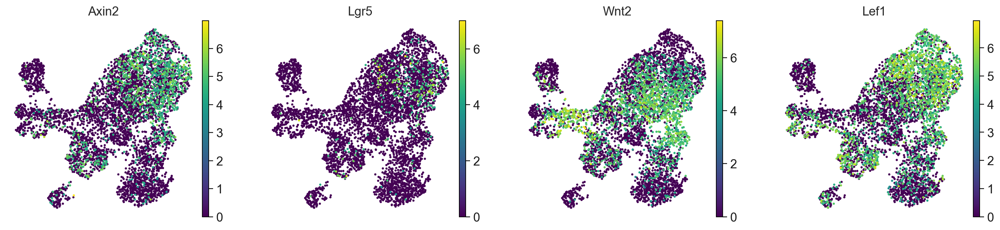

In [103]:
sc.pl.umap(a, color=["Axin2", "Lgr5", "Wnt2", "Lef1"], frameon=False, size=25, save="E10pt5_Axin2_Lgr5_Wnt2_Lef1.svg")

In [ ]:
a.obs["cell type original"] = a.obs["cell type"].copy()

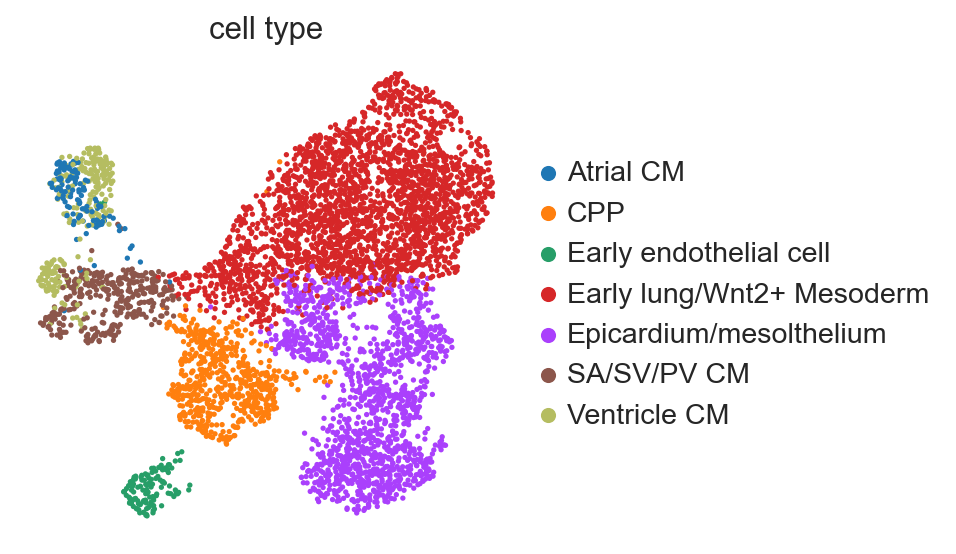

In [91]:
factor = "cell type"
a.obs[factor] = "Early lung/Wnt2+ Mesoderm"

a.obs.loc[a.obs["leiden"].isin(["3"]), factor] = "CPP"
a.obs.loc[a.obs["leiden"].isin(["2","4","8"]), factor] = "Epicardium/mesolthelium"
a.obs.loc[a.obs["leiden"].isin(["11"]), factor] = "Early endothelial cell"

a.obs.loc[a.obs["leiden"].isin(["5","9"]), factor] = a.obs.loc[a.obs["leiden"].isin(["5","9"]), factor + " original"]
a.obs.loc[a.obs["leiden"].isin(["5","9"]) & a.obs.loc[a.obs["leiden"].isin(["5","9"]), factor].isin(["ASM", "Capillary EC", "Pericyte"]), factor] = "Ventricle CM"

sc.pl.umap(a, color=["cell type"], frameon=False, save="_paper_E10pt5_refined_cell_type.svg")

In [ ]:
def get_msigdb_gene_list(
    gene_lists,
    organism = "hsapiens"
):
    """
    Given an Msigdb gene list name (or a list thereof), 
    return the genes in the list if the named list
    is found. 
    
    Output type differs depending on whether a single
    list name is provided or a list of list names is
    provided as a parameter to this function. Provide a 
    list to receive back a dictionary of lists of genes 
    and save time parsing msigdb. Provide a single list 
    name as a string to receive back a single list of genes.
    
    Sister function parse_msigdb needs to be changed to
    point to local directory containing downloaded
    msigdb gene lists.
    
    Paramters
    ---------
    gene_lists: str or list of str
        The name(s) of the msigdb gene lists
    
    organism: str (default: "hsapiens")
        Organism identifier to query gene
        lists from. One of:
            * hsapiens
            * mmusculus
    
    Returns
    -------
    one of: 
    
    gene_list: list of str
        Returned if only a single str is passed
        to this function; the list of genes corresponding 
        to the named msigdb gene list
    
    gene_lists: dict of list of str
        Returned if a list of str is passed as a parameter
        to this function; a dictionary with gene list names
        as keys and their corresponding list of genes as
        values 
    
    """
    # get msigdb in usable format
    msigdb = parse_msigdb(organism = organism)
    
    ret = {}
    if (isinstance(gene_lists, str)):
        gene_lists = [gene_lists]
    
    for name in gene_lists:
        # find the gene list
        if (name in msigdb.keys()):
            if (len(gene_lists) == 1):
                return msigdb[name]
            else:
                ret[name] = msigdb[name]
        else:
            print(name + " not found")
    return ret

def parse_msigdb(organism = "hsapiens"):
    if (organism == "hsapiens"):
        fname = "msigdb.v7.5.1.symbols.gmt"
    elif (organism == "mmusculus"):
        fname = "msigdb.v2023.1.Mm.symbols.gmt"
    
    save_dir = "../data/"
    genelists = {}
    with open(os.path.join(save_dir,fname), "r") as f:
        for r in f.readlines():
            s = r.replace("\n","").split("\t")
            genelists[s[0]] = s[2:]
    return genelists

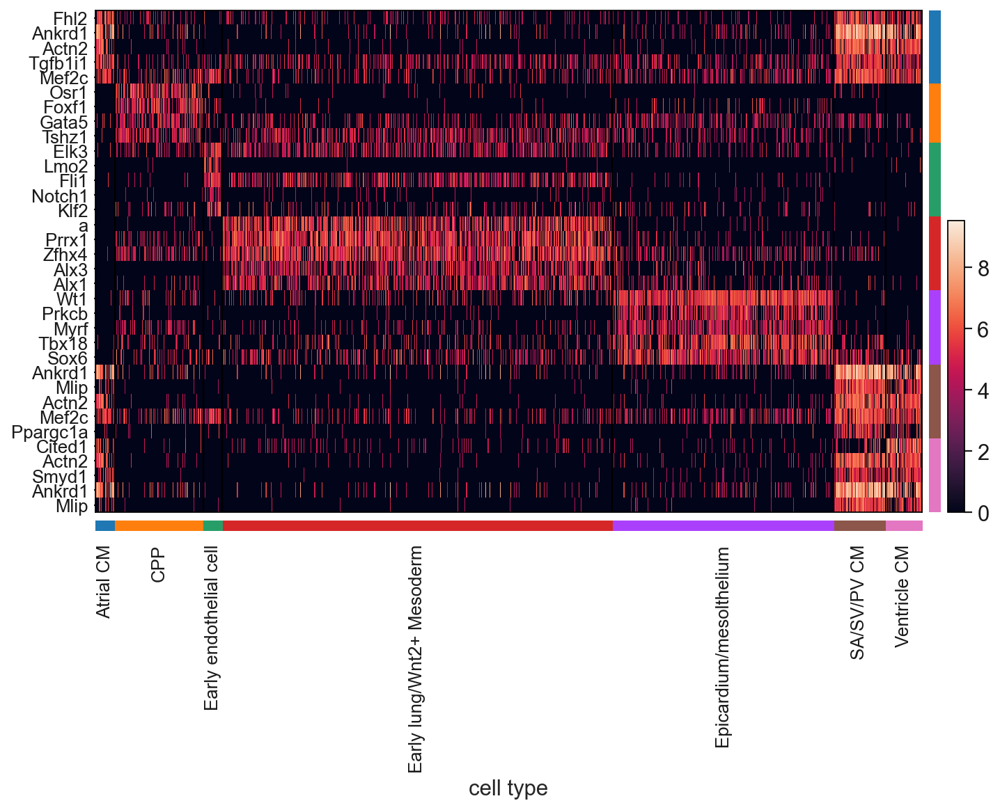

In [95]:
terms = [
    "GOMF_DNA_BINDING_TRANSCRIPTION_ACTIVATOR_ACTIVITY",
    "GOBP_CHROMATIN_REMODELING",
    "GOMF_TRANSCRIPTION_REGULATOR_ACTIVITY",
]

genes_of_interest = []
for term in terms:
    genes_of_interest += get_msigdb_gene_list(term, organism="mmusculus")
genes_of_interest = natsorted(adata[:, adata.var["mmusculus_gene"].isin(genes_of_interest)].var.index.tolist())
n_top_genes = 5

cell_cycle_genes = get_msigdb_gene_list("GOBP_CELL_CYCLE", organism="mmusculus") + ["Top2a", "Mki67"]
genes_of_interest = [g for g in genes_of_interest if not (g in cell_cycle_genes)]

b = a[:, a.var.index.isin(genes_of_interest)].copy()

factor = "cell type"
min_lfc = 1.0
min_in_group = 0.55
max_out_group = 0.4

sc.tl.dendrogram(b, groupby=factor, optimal_ordering=True)
sc.tl.rank_genes_groups(b, factor, pts=True, method='wilcoxon')
sc.tl.filter_rank_genes_groups(
    b, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group,
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group,
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_heatmap(
    b, 
    key="rank_genes_groups_filtered", 
    n_genes=n_top_genes, 
    dendrogram=False, 
    groupby=factor,
    swap_axes=True,
    show=False, 
    cmap="rocket",
    vmin=0, 
    show_gene_labels=True
)
fig["heatmap_ax"].figure.savefig("figures/heatmap_E10pt5_celltype_refined_tfs_swapped.svg")
del b

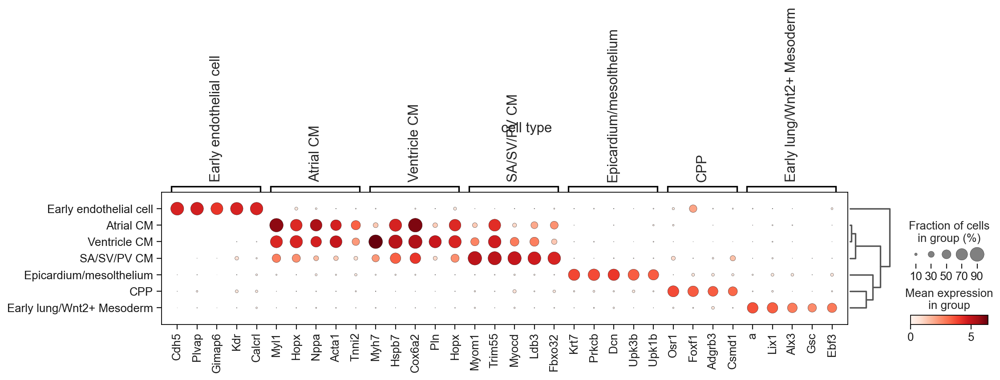

In [366]:
factor = "cell type"
min_lfc = 1
min_in_group = 0.45
max_out_group = 0.1
n_top_genes = 5

sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(
    a, 
    factor, 
    pts=True, 
    method='t-test_overestim_var'
)
sc.tl.filter_rank_genes_groups(
    a, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group,
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group,
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_dotplot(
    a, 
    key="rank_genes_groups_filtered",
    n_genes=n_top_genes,
    dendrogram=True,
    groupby=factor,
    title=factor,
    swap_axes=False,
    return_fig=True
)
fig.savefig("figures/dotplot_paper_E10pt5_celltype_markers.svg")

categories: Atrial CM, CPP, Early endothelial cell, etc.
var_group_labels: Early endothelial cell, Atrial CM, Ventricle CM, etc.


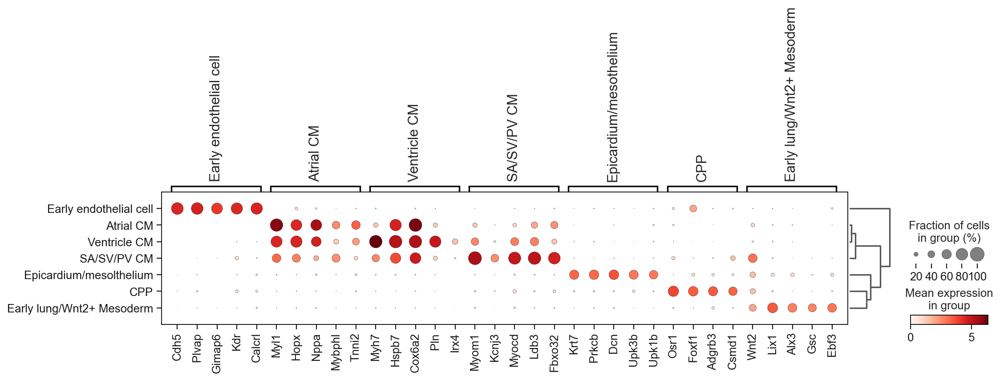

In [163]:
factor = "cell type"

marker_dict = {
    "Early endothelial cell":    ["Cdh5", "Plvap", "Gimap6", "Kdr", "Calcrl"],
    "Atrial CM":                 ["Myl1", "Hopx", "Nppa", "Mybphl", "Tnni2"],
    "Ventricle CM":              ["Myh7", "Hspb7", "Cox6a2", "Pln", "Irx4"],
    "SA/SV/PV CM":               ["Myom1", "Kcnj3", "Myocd", "Ldb3", "Fbxo32"],
    "Epicardium/mesothelium":    ["Krt7", "Prkcb", "Dcn", "Upk3b", "Upk1b"],
    "CPP":                       ["Osr1", "Foxf1", "Adgrb3", "Csmd1"],
    "Early lung/Wnt2+ Mesoderm": ["Wnt2", "Lix1", "Alx3", "Gsc", "Ebf3"]
}

sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")
fig = sc.pl.dotplot(
    a, 
    marker_dict,
    groupby=factor,
    dendrogram=True,
    vmin=0,
    return_fig=True
)
fig.savefig("figures/dotplot_paper_E10pt5_celltype_markers_selected.svg")

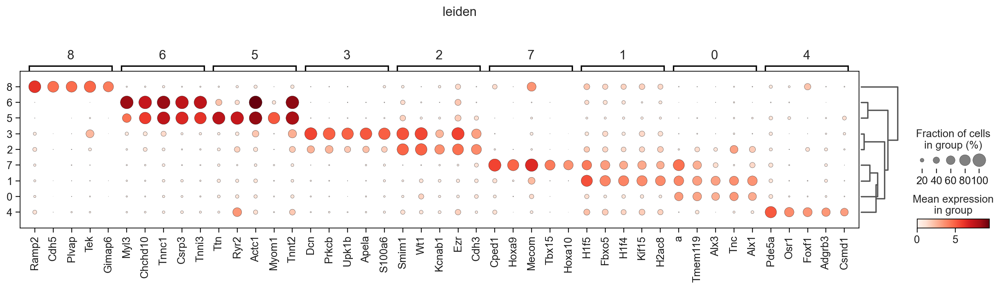

In [183]:
factor = "leiden"
min_lfc = 1.5
min_in_group = 0.5
max_out_group = 0.325
n_top_genes = 5

sc.tl.dendrogram(a, groupby=factor, optimal_ordering=True, linkage_method="centroid")

sc.tl.rank_genes_groups(a, factor, pts=True, method='t-test_overestim_var')
sc.tl.filter_rank_genes_groups(
    a, 
    key_added='rank_genes_groups_filtered', 
    min_in_group_fraction=min_in_group,
    min_fold_change=min_lfc,
    max_out_group_fraction=max_out_group,
    compare_abs=False
)

fig = sc.pl.rank_genes_groups_dotplot(
    a, 
    key="rank_genes_groups_filtered",
    n_genes=n_top_genes,
    dendrogram=True, 
    groupby=factor,
    title=factor, 
    swap_axes=False,
    return_fig=True
)
fig.savefig("figures/dotplot_paper_E10pt5_leiden_markers.svg")

### Do the trajectory inference

In [ ]:
def do_pseudotime(
    adata, 
    starter_cell_ID=None,
    terminal_states=None,
    use_rep="X_pca"
):    
    pca = pd.DataFrame(adata.obsm[use_rep], index=adata.obs.index)
    dm_res = palantir.utils.run_diffusion_maps(
        pca, 
        n_components=10, 
        knn=30, 
        alpha=0
    )
    ms_data = palantir.utils.determine_multiscale_space(dm_res)
    
    start_cell = starter_cell_ID

    try:
        pr_res = palantir.core.run_palantir(
            ms_data, 
            start_cell, 
            terminal_states=terminal_states,
            num_waypoints=500, 
            scale_components=False,
            n_jobs=1
        )
    except Exception as e:
        print("Pseudotime trajectory failed to converge - try again with different starting cell")
        print(e)
        return adata

    adata.obs["pseudotime"] = pr_res.pseudotime[adata.obs.index]
    adata.obs["differentiation_potential"] = pr_res.entropy[adata.obs.index]
    
    # drop old branch probabilities if they exist, then add new ones
    adata.obs.drop(list(adata.obs.filter(regex='pt_branch_prob_')), axis=1, inplace=True)
    for i, branch in enumerate(pr_res.branch_probs.columns):
        adata.obs["pt_branch_prob_" + str(i)] = pr_res.branch_probs.loc[adata.obs.index, branch]

    return adata

In [9]:
b = a.copy()

In [72]:
b.obs["pseudotime"] = 0
b.obs["differentiation_potential"] = 0

start_groups = [3]
start_cell = b[b.obs["leiden"]==str(start_groups[0])].obs.index.tolist()[3]
b = do_pseudotime(b, start_cell, use_rep="X_scVI")

Determing nearest neighbor graph...
Sampling and flocking waypoints...
Time for determining waypoints: 0.0033739089965820314 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.06279748678207397 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9998
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Identification of terminal states...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


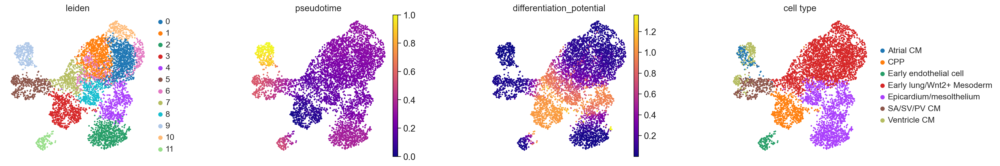

In [73]:
sc.pl.umap(b, color=["leiden", "pseudotime", "differentiation_potential", "cell type"], cmap="plasma", wspace=0.5, frameon=False)

pt_branch_prob_0
pt_branch_prob_1
pt_branch_prob_2


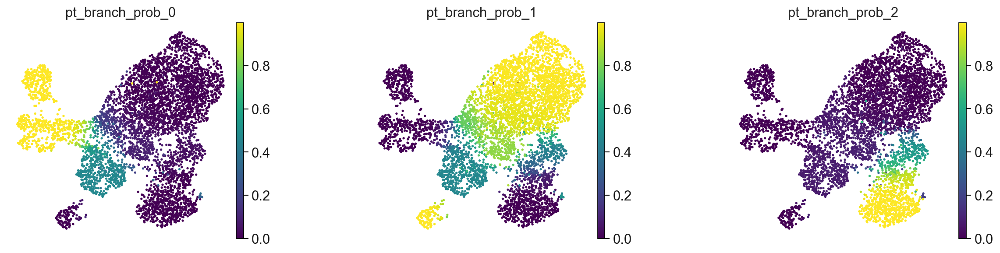

In [76]:
plot_me = []
for x in b.obs.columns:
    if ("pt_branch" in x):
        print(x)
        plot_me.append(x)
sc.pl.umap(b, color=plot_me, wspace=0.45, ncols=3, frameon=False)

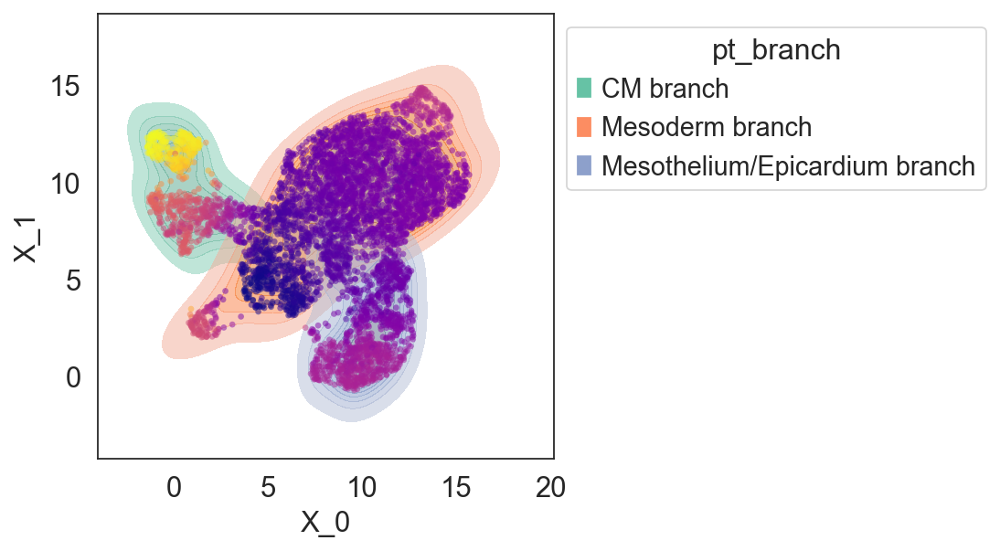

In [352]:
def plot_pseudotime_branch_prob_kde(
    adata,
    scatter_color=None,
    scatter_cmap="plasma",
    use_rep="X_umap"
):
    columns = [col for col in adata.obs.columns if ("pt_branch" in col)]
    if (scatter_color in adata.obs.columns):
        columns += [scatter_color]
    df = pd.DataFrame(index=adata.obs.index, data=adata.obs[columns])
    df["X_0"] = adata.obsm[use_rep][:,0]
    df["X_1"] = adata.obsm[use_rep][:,1]
    
    with sns.axes_style("white"):
        ax = sns.kdeplot(
            data=df, 
            x="X_0", 
            y="X_1", 
            hue="pt_branch", 
            weight="pt_branch_prob",
            bw_adjust=1.75,
            fill=True,
            alpha=0.5,
            palette="Set2"
        )
    if (scatter_color in df.columns):
        plt.scatter(
            x=df["X_0"], 
            y=df["X_1"],
            c=df[scatter_color],
            cmap=scatter_cmap,
            marker='.',
            lw=0,
            alpha=0.5,
            rasterized=True
        )
    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
    return ax
ax = plot_pseudotime_branch_prob_kde(b, "pseudotime", scatter_cmap="plasma")
ax.figure.savefig("figures/paper_E10pt5_pseudotime_branch_kde.svg")

### Set the branch categories

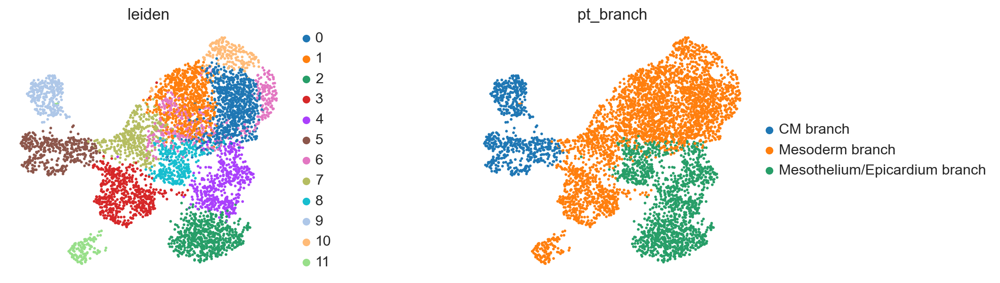

In [79]:
branches = {
    "0": [3,5,9],
    "1": [0,1,3,6,7,8,11],
    "2": [2,3,4,8],
}

branch_names = ["CM branch", "Mesoderm branch", "Mesothelium/Epicardium branch"]
b.obs["pt_branch"] = branch_names[1]
b.obs["pt_branch_prob"] = 0

for i,branch in enumerate(branches.keys()):
    b.obs["pt_branch_"+branch] = False
    b.obs.loc[b.obs["leiden"].isin([str(x) for x in branches[branch]]), "pt_branch_"+branch] = True
    b.obs.loc[b.obs["leiden"].isin([str(x) for x in branches[branch]]), "pt_branch_prob"] = b.obs.loc[b.obs["leiden"].isin([str(x) for x in branches[branch]]), "pt_branch_prob_"+branch]
    b.obs.loc[b.obs["leiden"].isin([str(x) for x in branches[branch]]), "pt_branch"] = branch_names[i]

b.obs.loc[b.obs["leiden"].isin(["3"]), "pt_branch"] = branch_names[1]
sc.pl.umap(b, color=["leiden"] + ["pt_branch"], wspace=0.5, frameon=False)

### Gene trend analysis

In [ ]:
def impute_adata(adata):
    """
    Imputes adata.X using magic and clips
    resulting values to be >= 0.
    """
    
    adata.layers["imputed"] = np.clip(
        sc.external.pp.magic(
            adata,
            t=2, 
            solver="approximate",
            n_pca=19, 
            n_jobs=6,
            copy=True
        ).X, 
        a_min=0,
        a_max=None
    )
    
    return None

In [ ]:
def calculate_gene_trends(
    adata, 
    list_of_genes, 
    branch_ID=None, 
    normalized=False,
    layer="imputed",
    n_splines=5,
    spline_order=3
):
    """
    Given a list of genes, fits a PoissonGAM 
    trendline and confidence intervals to the
    pseudotime-ordered cells that belong to a
    given branch. 
    
    Parameters
    ----------
    
    adata: ad.AnnData
        The AnnData object
    
    list_of_genes: list[str]
        The list of genes
    
    branch_ID: uint (default: None)
        The ID of the pseudotime branch that
        the trendline needs to be fit across.
        If None (default), use all cells.
    
    normalized: bool (default: False)
        If True, normalize expression values to 
        be in range [0,1]
    
    layer: str (default: "imputed")
        The layer key that exists in adata.layers
        to pull gene expression values from.
    
    n_splines: uint (default: 5)
        The number of splines to fit in the 
        PoissonGAM trendline. 
    
    spline_order: uint (default: 3)
        The polynomial order of the splines used
        to fit the PoissonGAM trendline.
    
    Returns
    -------
    
    gene_trends: pd.DataFrame
        The fitted trendlines and associated confidence
        intervals for each cell along the relevant
        pseudotime trajectory. Index is in range [0, 1]
        to correspond with min/max pseudotime. Columns
        are gene names (as well as _ci_upper/_ci_lower)
        containing values for the trend lines.
    
    """
    
    obs = adata.obs

    if (branch_ID in [None, -1]):
        branch_probs = None
    else:
        branch_probs = obs["pt_branch_prob_" + str(branch_ID)]

    pseudotime = obs["pseudotime"]

    if ((branch_ID == -1) or (branch_probs is None)):
        cells_in_branch = obs.index
    else:
        cells_in_branch = obs[obs["pt_branch_prob_" + str(branch_ID)] > 0.2].index

    X_train = pseudotime.to_numpy()
    
    # reduce the number of data points we fit to save computation time
    max_samples_to_fit = 5000
    if (len(X_train) <= max_samples_to_fit):
        subsample_mask = np.ones_like(X_train)
    else:
        subsample_mask = np.zeros_like(X_train)
        subsample_mask[0:max_samples_to_fit] = 1
        np.random.shuffle(subsample_mask) # inplace
    subsample_mask = np.array(subsample_mask, dtype=bool)

    if ((branch_ID != -1) and not (branch_probs is None)):
        weights = branch_probs.to_numpy()
    else:
        weights = np.ones_like(X_train)

    X_train = X_train[subsample_mask]
    weights = weights[subsample_mask]

    X_train = np.reshape(X_train, (len(X_train), 1))
    weights = np.reshape(weights, (len(weights), 1))

    X_plot = np.linspace(
        np.min(obs["pseudotime"][cells_in_branch]), 
        np.max(obs["pseudotime"][cells_in_branch]), 
        125
    )

    gene_trends = pd.DataFrame()
    gene_trends["pseudotime"] = X_plot
        
    for gene in list_of_genes:
        Y_train = adata.obs_vector(gene, layer=layer)
        if (normalized):
            Y_train = (Y_train - np.min(Y_train)) / (np.max(Y_train) - np.min(Y_train))
        Y_train = Y_train[subsample_mask]

        gam = PoissonGAM(n_splines=n_splines, spline_order=spline_order)
        
        gam.gridsearch(X_train, Y_train, weights=weights, progress=False)

        try:
            gene_trends[gene] = np.clip(
                gam.predict(X_plot), -8, 8
            )
        except AttributeError as e:
            gam.fit(X_train, Y_train, weights=weights)
            gene_trends[gene] = np.clip(
                gam.predict(X_plot), -8, 8
            )
        
        ci = gam.confidence_intervals(X_plot, width=.95)
        gene_trends[gene + "_ci_upper"] = np.clip(ci[:,1], -8, 8)
        gene_trends[gene + "_ci_lower"] = np.clip(ci[:,0], -8, 8)
        
    return gene_trends


In [ ]:
def plot_gene_trends(
    adata, 
    genes_of_interest, 
    branch_ID=-1, 
    trends=None, 
    normalized=False,
    dots=False, 
    return_fig=False,
    cmap="magma",
    layer="imputed"
):
    """
    Given a list of genes, plot the GAM trendline
    along the pseudotime branch, optionally calculating
    the trendline on-demand or providing the pd.DataFrame
    with pre-calculated gene trends.
    
    See calculate_gene_trends for more information.
    """
    
    colors = plt.get_cmap(cmap)(np.linspace(0.1,0.9,len(genes_of_interest)))
    
    for g in genes_of_interest:
        if not (g in adata.var.index):
            genes_of_interest.remove(g)
    
    if (trends is None):
        trends = calculate_gene_trends(
            adata,
            genes_of_interest,
            layer=layer,
            branch_ID=branch_ID,
            normalized=normalized
        )
        
    ax = plt.figure(figsize=(6,3))
    for i,g in enumerate(genes_of_interest):
        if (dots):
            if (branch_ID == -1):
                mask = adata.obs.index
            else:
                mask = (adata.obs["pt_branch_prob_" + str(branch_ID)] > 0.2)
            x_dots = adata[mask].obs["pseudotime"].tolist()
            y_dots = adata[mask].obs_vector(g, layer=layer)
            if (normalized):
                y_dots = (y_dots - np.min(y_dots)) / (np.max(y_dots) - np.min(y_dots))
            plt.scatter(x_dots, y_dots, color=colors[i], alpha=0.5, marker=".")
        
        x = trends["pseudotime"]
        plt.fill_between(x, trends[g+"_ci_upper"], y2=trends[g+"_ci_lower"], color=colors[i], alpha=0.4)
        plt.plot(x, trends[g], '-', lw=3, color=colors[i], label=g)
    
    legend_n_col = (3 if (len(genes_of_interest)> 6) else 1)
    plt.legend(loc="upper left", ncol=legend_n_col, bbox_to_anchor=(1.05,1))
    
    if (return_fig):
        return ax
    else:
        plt.show()

In [19]:
impute_adata(b)

In [21]:
sc.pp.highly_variable_genes(b, flavor="cell_ranger", n_top_genes=2000)

all_trends = []
for i,branch in tqdm(enumerate(branches.keys())):
    branch_col = "pt_branch_" + branch
    c = b[b.obs[branch_col], b.var["highly_variable"]]
    trends = calculate_gene_trends(c, c.var.index.tolist())
    all_trends.append(trends)
all_trends[0]

3it [13:41, 273.86s/it]


,pseudotime,AA465934,AA465934_ci_upper,AA465934_ci_lower,AU021092,AU021092_ci_upper,AU021092_ci_lower,AW112010,AW112010_ci_upper,AW112010_ci_lower,...,Zic1_ci_lower,Zim1,Zim1_ci_upper,Zim1_ci_lower,Zyg11a,Zyg11a_ci_upper,Zyg11a_ci_lower,a,a_ci_upper,a_ci_lower
0,0.000000,0.732466,0.825419,0.649981,0.001615,0.010431,0.000250,0.008633,0.027701,2.690558e-03,...,0.009905,1.380190,1.544616,1.233266,0.001229,0.012391,0.000122,0.417432,0.490019,0.355597
1,0.008065,0.721671,0.810320,0.642721,0.001675,0.010457,0.000268,0.008282,0.025733,2.665336e-03,...,0.009815,1.363566,1.509962,1.231363,0.001233,0.012111,0.000126,0.406674,0.475236,0.348003
2,0.016129,0.711142,0.795787,0.635501,0.001737,0.010486,0.000288,0.007945,0.023961,2.634139e-03,...,0.009721,1.348350,1.479618,1.228727,0.001237,0.011840,0.000129,0.396242,0.461092,0.340513
3,0.024194,0.700874,0.781805,0.628321,0.001800,0.010518,0.000308,0.007621,0.022368,2.596674e-03,...,0.009625,1.334459,1.453467,1.225195,0.001241,0.011577,0.000133,0.386128,0.447565,0.333124
4,0.032258,0.690863,0.768362,0.621181,0.001866,0.010553,0.000330,0.007311,0.020938,2.552716e-03,...,0.009526,1.321815,1.431391,1.220628,0.001246,0.011323,0.000137,0.376322,0.434633,0.325834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,0.967742,0.689131,0.803163,0.591290,0.001971,0.019789,0.000196,0.000059,0.045906,7.560675e-08,...,0.003814,0.153621,0.209725,0.112525,0.001484,0.025638,0.000086,0.104644,0.150946,0.072544
121,0.975806,0.697688,0.816023,0.596514,0.001902,0.019862,0.000182,0.000057,0.046742,6.833153e-08,...,0.003805,0.146049,0.201547,0.105832,0.001483,0.026399,0.000083,0.104963,0.152446,0.072270
122,0.983871,0.706389,0.829263,0.601723,0.001835,0.019939,0.000169,0.000054,0.047594,6.175567e-08,...,0.003796,0.138803,0.193789,0.099419,0.001483,0.027184,0.000081,0.105295,0.153998,0.071995
123,0.991935,0.715234,0.842887,0.606914,0.001771,0.020020,0.000157,0.000052,0.048462,5.581202e-08,...,0.003786,0.131872,0.186434,0.093279,0.001482,0.027996,0.000078,0.105638,0.155601,0.071717


branch: 0 running
Finding 150 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.062146902084350586 seconds
Jaccard graph constructed in 0.7179503440856934 seconds
Wrote graph to binary file in 0.05908989906311035 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.117808
Louvain completed 21 runs in 3.3239223957061768 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 4.811485052108765 seconds
branch: 1 running
Finding 150 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.04232931137084961 seconds
Jaccard graph constructed in 0.7716152667999268 seconds
Wrote graph to binary file in 0.051529884338378906 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.227829
Louvain completed 21 runs in 3.1951711177825928 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 4.753270149230957 seconds
branch

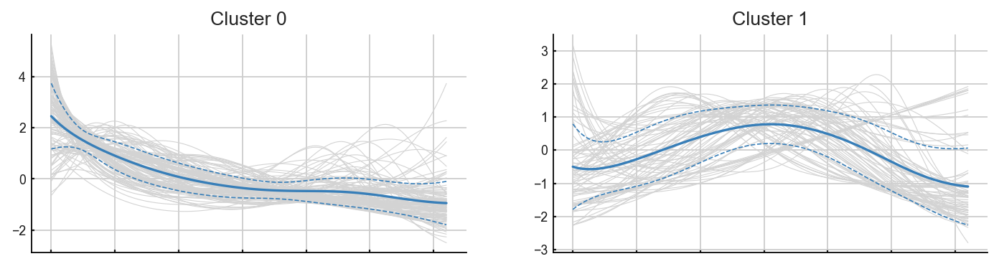

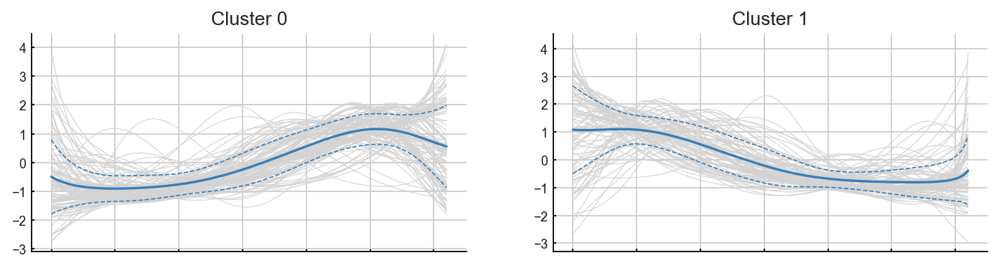

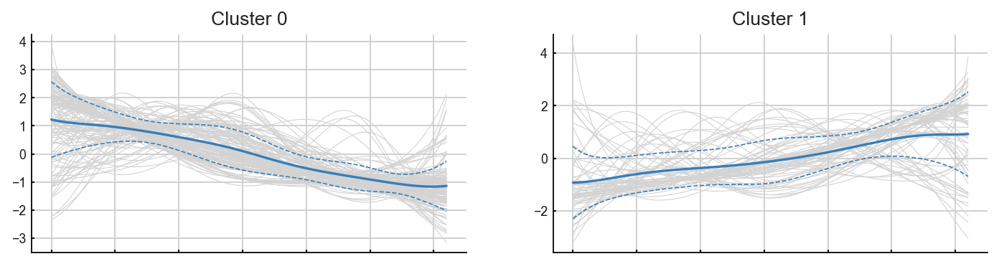

In [362]:
gene_clusters = []
for i in range(0, len(branch_names)):
    print("branch:", i, "running")
    df = all_trends[i]
    df = df[[c for c in df.columns if not (("ci" in c) or ("pseudotime") in c)]]
    clusters = palantir.presults.cluster_gene_trends(df.T)
    gene_clusters.append(clusters)
    palantir.plot.plot_gene_trend_clusters(df.T, clusters)
    clusters.to_csv("tables/pseudotime/"+ branch_names[i].replace("/", "-") + "_tf_gene_trend_cluster_assignments.csv")

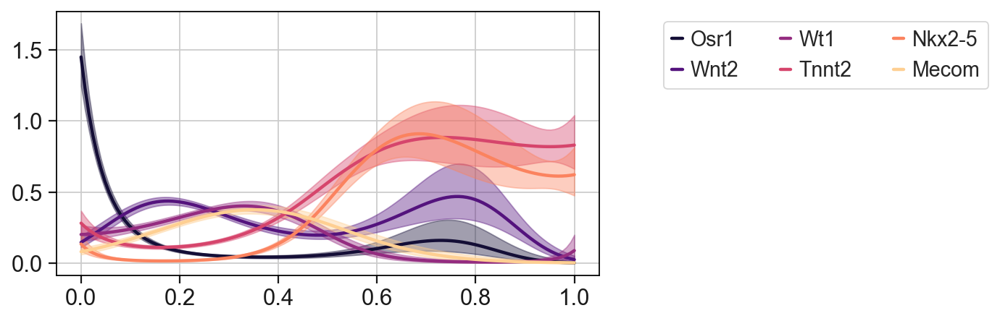

In [167]:
plot_gene_trends(
    b, 
    ["Osr1", "Wnt2", "Wt1", "Tnnt2", "Nkx2-5", "Mecom"], 
    branch_ID=None, 
    trends=None, 
    normalized=True,
    dots=False, 
    return_fig=False
)

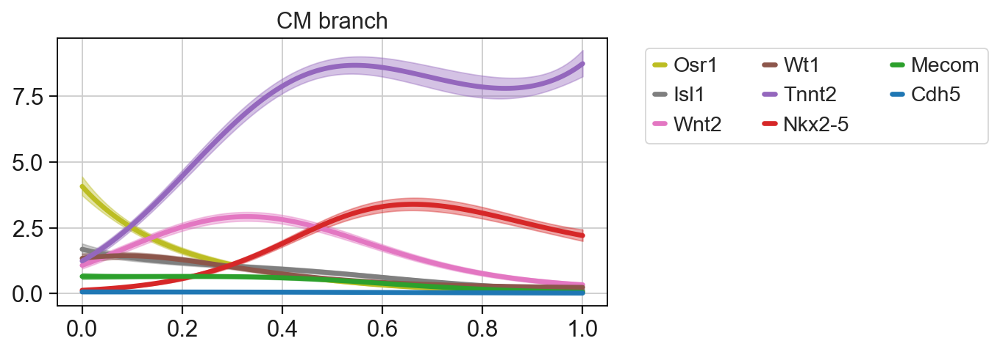

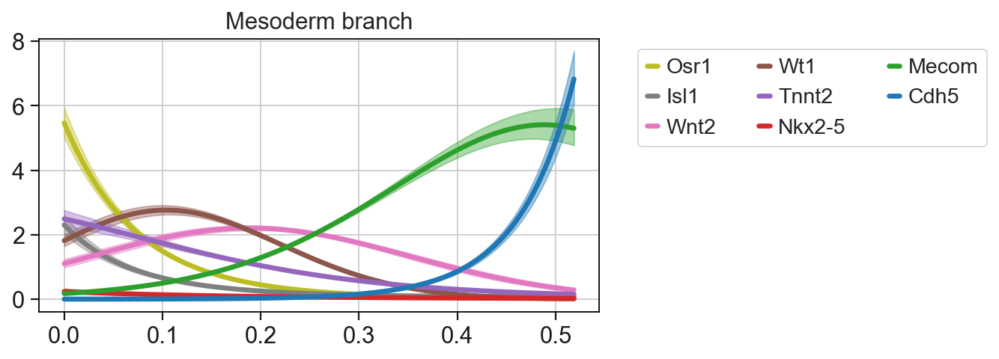

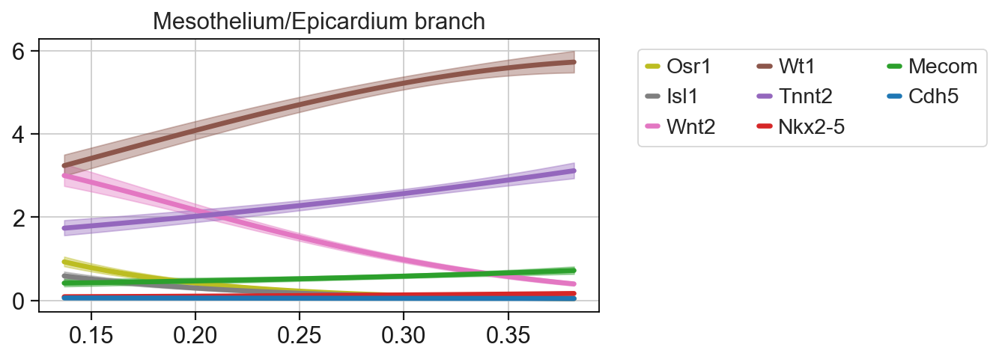

In [157]:
for i in range(0, 3):
    fig = plot_gene_trends(
        b, 
        ["Osr1", "Isl1", "Wnt2", "Wt1", "Tnnt2", "Nkx2-5", "Mecom", "Cdh5"], 
        branch_ID=i, 
        trends=None, 
        normalized=False,
        dots=False, 
        cmap="tab10_r",
        return_fig=True
    )
    plt.title(branch_names[i])
    #plt.tight_layout()
    plt.savefig("figures/paper_pseudotime_"+branch_names[i].replace("/","-")+"_new_selected_trends.svg")

## Figure 5: Transcription factor analysis

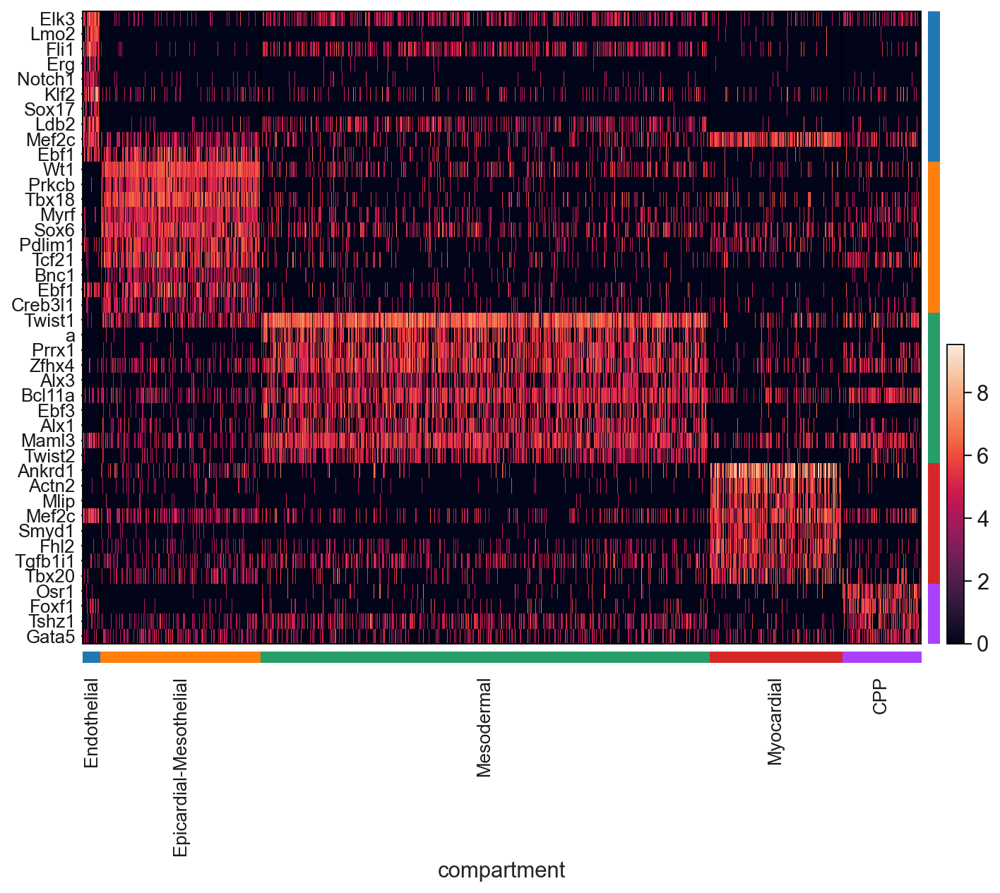

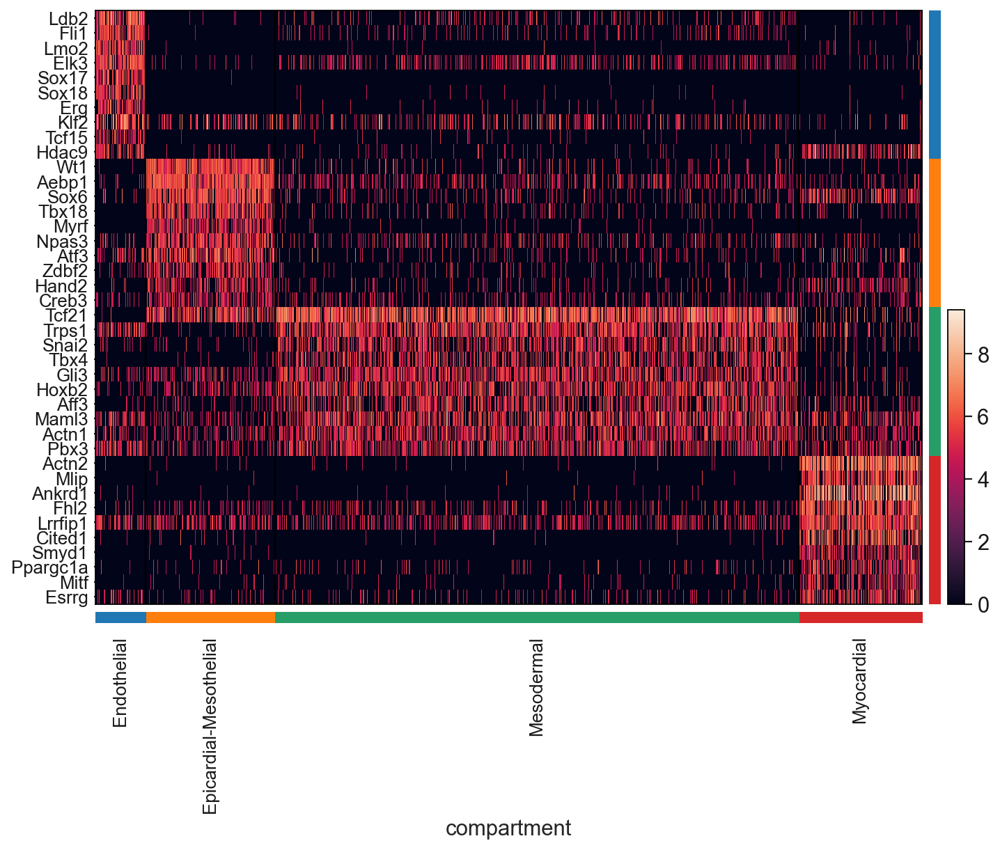

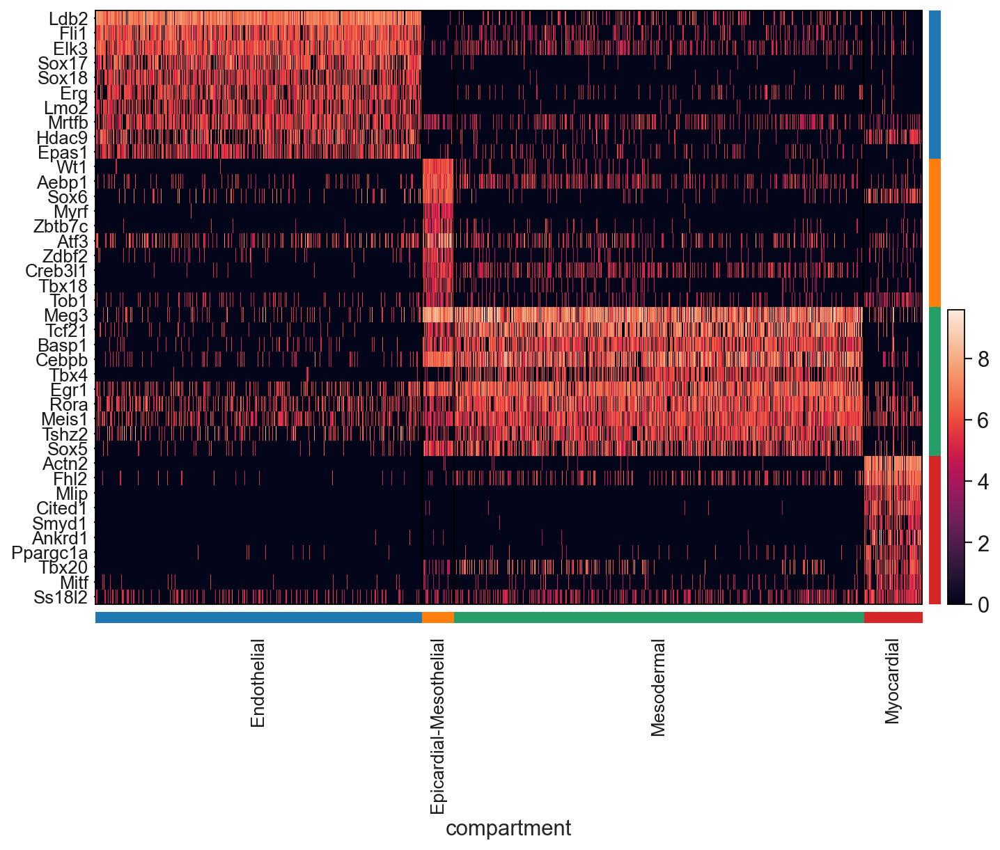

In [12]:
terms = [
    "GOMF_DNA_BINDING_TRANSCRIPTION_ACTIVATOR_ACTIVITY",
    "GOBP_CHROMATIN_REMODELING",
    "GOMF_TRANSCRIPTION_REGULATOR_ACTIVITY",
]

genes_of_interest = []
for term in terms:
    genes_of_interest += get_msigdb_gene_list(term, organism="mmusculus")
genes_of_interest = natsorted(adata[:, adata.var["mmusculus_gene"].isin(genes_of_interest)].var.index.tolist())

cell_cycle_genes = get_msigdb_gene_list("GOBP_CELL_CYCLE", organism="mmusculus") + ["Top2a", "Mki67"]
genes_of_interest = [g for g in genes_of_interest if not (g in cell_cycle_genes)]

gene_mask = ~adata.var["ignore"] & adata.var.index.isin(genes_of_interest)

mask = (adata.obs["age"].isin(["E10.5", "E12.5", "E17.5"]))
a = adata[mask, gene_mask].copy()

n_top_genes = 10

for age in a.obs["age"].cat.categories:
    mask = (a.obs["age"].isin([age]))
    b = a[mask, a.var.index.isin(genes_of_interest)].copy()
    
    if (age == "E10.5"):
        b.obs["compartment"] = b.obs["compartment"].astype(str)
        b.obs.loc[b.obs["cell type"] == "CPP", "compartment"] = "CPP"
        b.obs["compartment"] = b.obs["compartment"].astype("category").cat.reorder_categories(["Endothelial", "Epicardial-Mesothelial", "Mesodermal", "Myocardial", "CPP"])
    
    vmax = 3
    vmin = -1 * vmax
    b.layers["scaled"] = sc.pp.scale(b, copy=True).X

    factor = "compartment"
    min_lfc = 1
    min_in_group = 0.5
    max_out_group = 0.4
    
    sc.tl.dendrogram(b, groupby=factor, optimal_ordering=True, linkage_method="centroid")
    sc.tl.rank_genes_groups(b, factor, pts=True, method='wilcoxon')
    sc.tl.filter_rank_genes_groups(
        b, 
        key_added='rank_genes_groups_filtered', 
        min_in_group_fraction=min_in_group, 
        min_fold_change=min_lfc,
        max_out_group_fraction=max_out_group,
        compare_abs=False
    )

    fig = sc.pl.rank_genes_groups_heatmap(
        b, 
        key="rank_genes_groups_filtered", 
        n_genes=n_top_genes,
        dendrogram=False,
        groupby=factor,
        swap_axes=True,
        show=False, 
        cmap="rocket",
        vmin=0
    )
    fig["heatmap_ax"].figure.savefig("figures/heatmap_compartment_revised_" + age.replace(".", "pt") + "_tfs.svg")
    del b
del a

## Figure 6: Wnt2 HET vs. KO

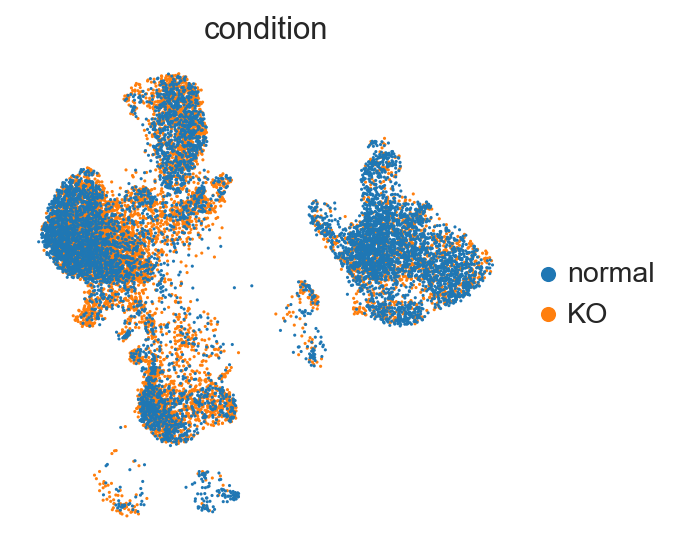

In [11]:
cell_mask = adata.obs["age"].isin(["E17"])
a = adata[cell_mask, :].copy()

sc.pl.umap(a, color=["condition"], frameon=False)

In [ ]:
def get_proportions(
    adata, 
    outer_col=None, 
    inner_col=None,
    return_counts=False
):
    """
    Calculates how many cells from each
    `outer_col` are also in `inner_col` as
    a fraction of the total cells in `outer_col`.
    
    Paramaters
    ----------
    adata: AnnData
        The anndata object
    
    outer_col: str
        The column name of the outermost column;
        often `batch`, `sample`, or `genotype`
    
    inner_col: str
        The column name of the innermost column;
        often `celltype`, `leiden`
        
    return_counts: bool (default: False)
        If `True`, return the number of cells,
        otherwise return the fraction.
   
    """
    
    if (outer_col in adata.obs.columns):
        if (inner_col in adata.obs.columns):
            groups = adata.obs.value_counts([outer_col, inner_col]).astype(float)
            count_data = groups.unstack(level=outer_col)
            count_data = count_data.fillna(0)
            if (return_counts):
                ret = count_data
            else:
                ret = count_data / count_data.apply(np.sum, axis=0)
            return ret
    print("[ERROR]: missing outer_col/innner_col")
    return None

### Barplots of cells per batch

In [1]:
def plot_batch_cluster_percent(
    adata, 
    factor_to_plot="cell type",
    split_by="condition",
    batch_key="batch",
    stacked=True
):
    
    '''
    Generates (stacked) bar plots of cell counts and
    proportions, with each bar representing how many
    cells are in each group of "factor_to_plot"
    across each group of "split_by". Cell counts are
    reported on a per-batch basis with batch 
    assignments found in the "batch_key" column of 
    the adata.obs table.
    
    Parameters
    ----------
    
    adata: AnnData object
        The anndata object
    
    factor_to_plot: str (default: "cell type")
        The factor in adata.obs to generate 
        count/proportion plots for
    
    split_by: str (default: "condition")
        The factor in adata.obs to compare/split
        by, such that groups of count/proportion
        bars are split across this factor. 
    
    batch_key: str (default: "batch")
        The factor in adata.obs that indicates 
        the batch a cell belongs to. This is used
        to normalize reported counts to cell
        counts per batch. Important when some
        conditions are represented by multiple
        batches and others are not so that 
        comparisons between conditions are fair.
    
    stacked: bool (default: True)
        If True, generate a stacked bar graph, 
        else stagger bars. 
        
    Returns
    -------
    
    fig: matplotlib.Figure with two graphs, one
    with counts per batch and one with proportions. 
    
    '''
    
    titles = ["# of cells per " + split_by, "cell proportions"]
    
    a = adata
    groups = a.obs[split_by].cat.categories
    fig, axs = plt.subplots(1,2, figsize=(10,5), constrained_layout=True)
    
    for i in range(0, len(titles)):
        # calculate counts/proportions
        if ("#" in titles[i]):
            return_counts = True
            n_samples = np.asarray(a.obs.groupby(split_by)[batch_key].nunique().tolist())
        else:
            return_counts = False
        d = get_proportions(a[a.obs[split_by].isin(groups)],
                            outer_col=split_by, 
                            inner_col=factor_to_plot,
                            return_counts=return_counts)
        d = d[groups]
        if ("#" in titles[i]):
            d = d / n_samples
        
        # generate the bar graphs
        if ((factor_to_plot+"_colors") in a.uns.keys()):
            d.T.plot.bar(stacked=stacked, color=a.uns[factor_to_plot+"_colors"], ax=axs[i])
        else:
            d.T.plot.bar(stacked=stacked, ax=axs[i])
        if (i==(len(titles)-1)):
            axs[i].legend(bbox_to_anchor=(1.1, 1.05), ncol=1)
        else:
            axs[i].get_legend().remove()
        axs[i].set_title(titles[i])
    
    ret = fig
    return ret

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


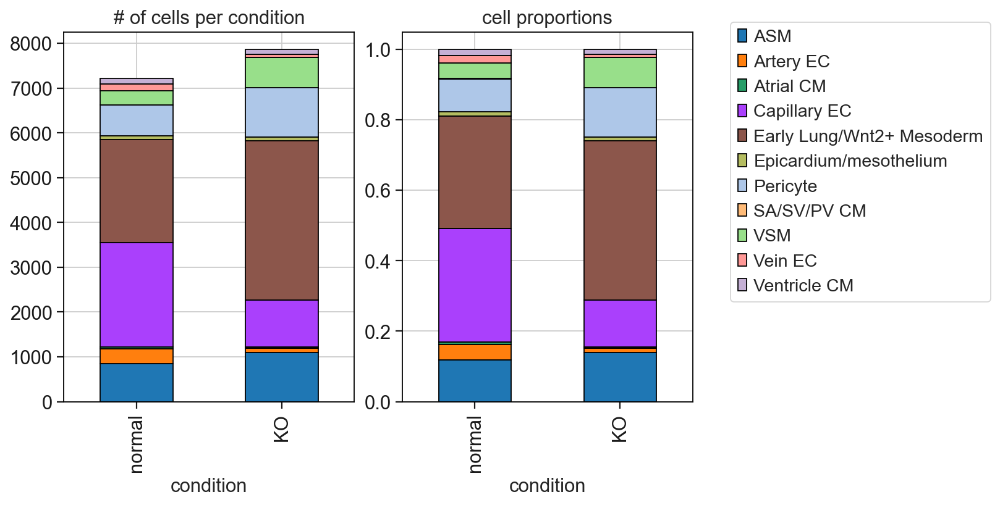

In [22]:
cell_mask = adata.obs["age_condition"].isin(["E17 normal", "E17 KO"]) 
a = adata[cell_mask,:]
fig = plot_batch_cluster_percent(
    a,
    factor_to_plot = "cell type",
    split_by = "condition"
)
fig.savefig("figures/barplot_E17_celltype_vs_condition.eps")
del a

In [60]:
cell_mask = adata.obs["age_condition"].isin(["E17 normal", "E17 KO"]) 
a = adata[cell_mask,:]

df = get_proportions(
    a, 
    outer_col="condition", 
    inner_col="cell type",
    return_counts=False
)
df.to_csv("tables/celltype_proportions_het_vs_ko.tsv", sep="\t")

In [61]:
cell_mask = adata.obs["age_condition"].isin(["E17 normal", "E17 KO"]) 
a = adata[cell_mask,:]

df = get_proportions(
    a, 
    outer_col="condition", 
    inner_col="cell type",
    return_counts=True
)
df.to_csv("tables/celltype_counts_het_vs_ko.tsv", sep="\t")

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


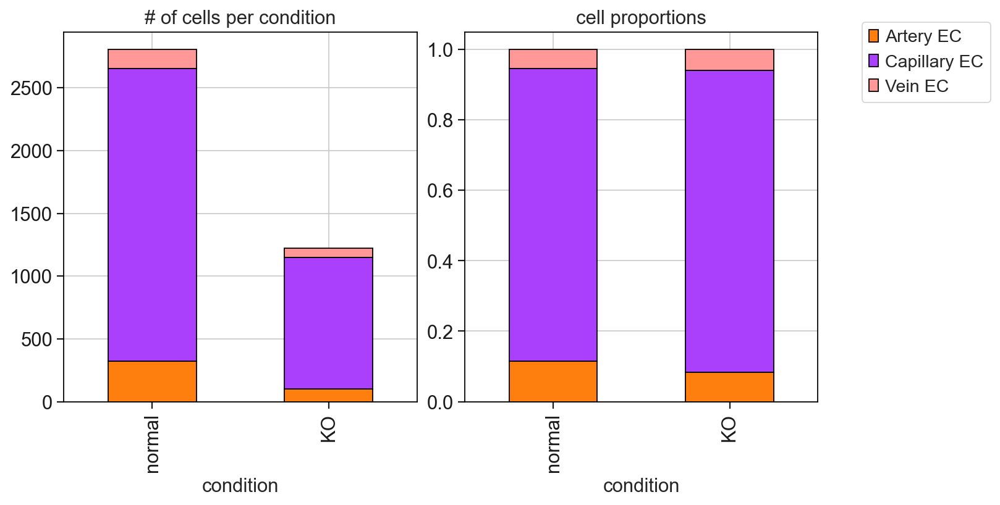

In [23]:
cell_mask = adata.obs["age_condition"].isin(["E17 normal", "E17 KO"]) & adata.obs["cell type"].isin(["Artery EC", "Vein EC", "Capillary EC"])
a = adata[cell_mask,:]
fig = plot_batch_cluster_percent(
    a,
    factor_to_plot = "cell type",
    split_by = "condition"
)
fig.savefig("figures/barplot_E17_ECs_celltype_vs_condition.eps")
del a

In [ ]:
factor_to_test = "condition"
factor_to_plot = "condition"

n_top_genes = 10

cell_mask = adata.obs["age"].isin(["E17"])

b = adata[cell_mask, ~adata.var["ignore"]].copy()
del b.layers

for celltype in b.obs["cell type"].cat.categories:
    try:
        mask = b.obs["cell type"] == celltype
        a = b[mask].copy()

        sc.tl.rank_genes_groups(a, factor_to_test, pts=True, method='wilcoxon')

        fig = sc.pl.rank_genes_groups_dotplot(
            a, 
            key="rank_genes_groups",
            n_genes=n_top_genes, 
            dendrogram=False,
            groupby=factor_to_plot,
            title=celltype, 
            swap_axes=True, 
            return_fig=True,
            min_logfoldchange=1.0
        )
        fig.add_totals(color="lightgrey").savefig("figures/dotplot_E17_" + celltype.replace("/", "_") + "_" + factor_to_plot + "_swapped.svg")

    except Exception as e:
        print("DEG test failed for: " + celltype)
        print(e)
    del a
del b

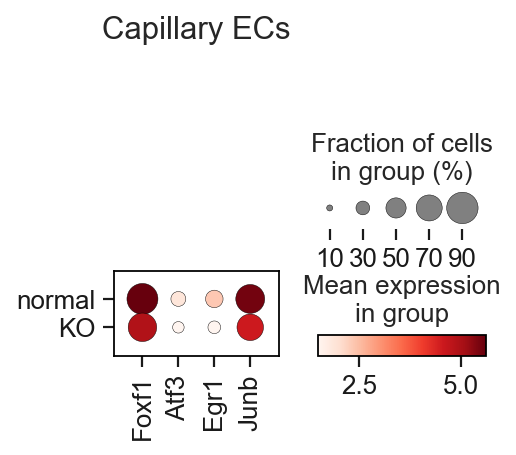

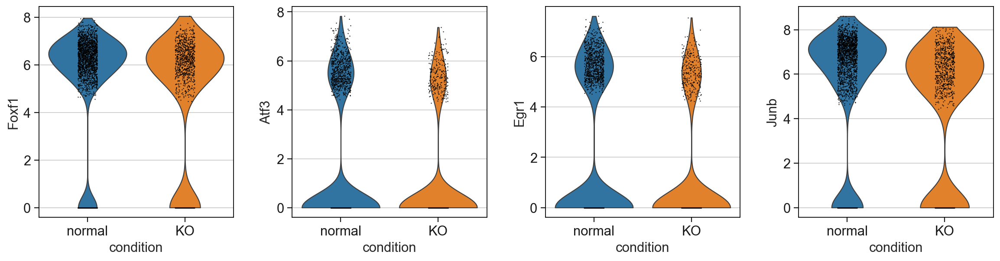

In [35]:
genes_of_interest = ["Foxf1", "Atf3", "Egr1", "Junb"]

mask = (adata.obs["age"] == "E17") & (adata.obs["cell type"].isin(["Capillary EC"]))
a = adata[mask, adata.var.index.isin(genes_of_interest)]

sc.pl.dotplot(
    a,
    genes_of_interest,
    groupby = "condition",
    var_group_rotation=0,
    vmin = 1.5,
    title = "Capillary ECs",
    save = "paper_capillary_EC_ctrl_vs_KO_selected_genes.svg"
)

sc.pl.violin(
    a,
    genes_of_interest,
    groupby = "condition",
    save = "paper_capillary_EC_ctrl_vs_KO_selected_genes.svg"
)